![data-x](http://oi64.tinypic.com/o858n4.jpg)


# Homework 7: Image Classification with pretrained CNN

#### This HW consists of 5 parts + One Extra Credit question (5p for Part 1-5, 2p for EC)

#### Author: Alexander Fred Ojala

.

* ## [Part 0: Data-X feedback survey](#sec0)

---

## Part 1-4: Build your own Cats vs Dogs binary classifier

In this HW we will implement a binary Cats vs Dogs classifier by removing the top layer of a pretrained network (VGG16 on Imagenet), extracting the features of the training and validation images and then just training the top layer of that network. This way we will be able to make accurate predictions even though we just have a small data set. This is very similar to the breakout given to you during lecture 7 (found in **module-06** in the Dropbox, folder **Breakout-CNN-CatsVsDogs**).

We want you to able to use the tools that we have presented so far. Therefore, in step 1-4 we want you to install Keras, extract the bottleneck features of your images, train the top layer and lastly make predicitons on images not presented to the CNN so far.

The data conists of 2000 training images (1000 cats and 1000 dogs), 800 validation images (400 cats and 400 dogs), and 100 test images (cats and dogs mixed). Find the data here: https://www.dropbox.com/s/y2suimh2lt5btam/data.zip?dl=1

The pretrained VGG16 weighs that you should load into your model (in order to extract the bottleneck features) can be downloaded here: https://www.dropbox.com/s/o7rxv6y2xf69jmw/vgg16_weights.h5?dl=0


The reason why we are using a pretrained network, extracting bottleneck features and training only the top layers is that this is a great way to obtain a high prediction accuracy without having to run the training for a long time. it would take up to several days to run this analysis and training your own CNN / DNN on a personal computer (in order to obtain the same level of accuracy).

.


* ## [Part 1: Install Keras and Theano (or Tensorflow) + all dependencies](#sec1)

.

* ## [Part 2: Extract bottleneck features from the data set](#sec2)

.

* ## [Part 3: Train the top layer of your CNN](#sec3)

.

* ## [Part 4: Make predicitons on the mixed test images](#sec4)

.

* ## [Extra credit: Train the network on the 50 image classes](#sec5)

___

<a id='sec0'></a>
# Part 0:

We'd love to get your feedback on what you think about the class so far, so as part of the HW please fill out this survey before next lecture: 

# https://goo.gl/forms/ETExtfhymrZJmw3J3

<a id='sec1'></a>

# Part 1: Install Keras + Theano (or Tensorflow)

As a data scientist you will have to be comfortable with installing and setting up your work environment on different systems. Therefore, this first part of the HW will be a valuable lesson on how to troubleshoot if you run into problems. Also, feel free to ask us for guidance either during Office Hours or on Piazza. We are here to help.

If you want you can also try to use Tensorflow as your Keras backend (instead of Theano, that has been shown in class so far). Note that there some syntax and dimension handling differences between these two libraries.

In [1]:
# Using Theano as a backend for Keras
from keras import backend as K
K.set_image_dim_ordering('th')

Using Theano backend.


In [2]:
# Import relevant packages
import h5py
import os, cv2, random
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
#from matplotlib import ticker
#import seaborn as sns
%matplotlib inline 

from keras.models import Sequential
from keras.layers import Input, Dropout, Flatten, Convolution2D, MaxPooling2D, Dense, Activation, ZeroPadding2D
from keras.optimizers import RMSprop
from keras.callbacks import ModelCheckpoint, Callback, EarlyStopping
from keras.utils import np_utils
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import array_to_img, img_to_array, load_img
from keras.models import model_from_json
from keras.preprocessing import image

from IPython.display import Image, display

# fix random seed for reproducibility
seed = 150
np.random.seed(seed)

<a id='sec2'></a>

# Part 2: Extract bottleneck features from the data set

In the second part you will use the pre-trained VGG network structure (loading in the pretrained VGG16 ImageNET weights). Then you will run your data set through that CNN ones to extract the image features.

A good explanation on how this works (rewritten from source: https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html)

#### Using the bottleneck features of a pre-trained network: 90% accuracy in 1 min (GPU) / 10 mins (CPU)

In Part 2 we leverage a network pre-trained on a large dataset. Such a network would have already learned features that are useful for most computer vision problems, and leveraging such features would allow us to reach a better accuracy than any method that would only rely on the available data.

We will use the VGG16 architecture, pre-trained on the ImageNet dataset -- that Kevin showed in Lecture 6. Because the ImageNet dataset contains several "cat" classes (persian cat, siamese cat...) and many "dog" classes among its total of 1000 classes, this model will already have learned features that are relevant to our classification problem. In fact, it is possible that merely recording the softmax predictions of the model over our data rather than the bottleneck features would be enough to solve our dogs vs. cats classification problem extremely well (Kevin showed that in Lecture 6). The method presented here is more likely to generalize well to a broader range of problems, including problems featuring classes absent from ImageNet.

Here's what the VGG16 architecture looks like:

![Image of Yaktocat](https://blog.keras.io/img/imgclf/vgg16_original.png)


**Strategy to extract bottleneck features:** We will only instantiate the convolutional part of the model, everything up to the fully-connected layers. We will then run this model on our training, validation and test data once, recording the output (the "bottleneck features" from the VGG16 model: the last activation maps before the fully-connected layers) in two numpy arrays. The reason why we are storing the features offline rather than adding our fully-connected model directly on top of a frozen convolutional base and running the whole thing, is computational effiency. Running VGG16 is expensive, especially if you're working on CPU, and we want to only do it once. Note, therefore we will not use data augmentation.

Store the bottleneck features as .npy files.

In [ ]:
#Look at folder data
!ls

In [3]:
# Look at files, note all cat images and dog images are unique
from __future__ import absolute_import, division, print_function # make it compatible w Python 3
import os
for path, dirs, files in os.walk('./data'):
    print('FOLDER',path)
    for f in files[:4]:
        print(f)

FOLDER ./data
.DS_Store
FOLDER ./data/test
.DS_Store
FOLDER ./data/test/catvdog
try001.jpg
try002.jpg
try003.jpg
try004.jpg
FOLDER ./data/train
.DS_Store
FOLDER ./data/train/cats
cat0001.jpg
cat0002.jpg
cat0003.jpg
cat0004.jpg
FOLDER ./data/train/dogs
dog0001.jpg
dog0002.jpg
dog0003.jpg
dog0004.jpg
FOLDER ./data/validation
.DS_Store
FOLDER ./data/validation/cats
cat001001.jpg
cat001002.jpg
cat001003.jpg
cat001004.jpg
FOLDER ./data/validation/dogs
dog001001.jpg
dog001002.jpg
dog001003.jpg
dog001004.jpg


In [6]:
print('Number of cat training images:', len(next(os.walk('./data/train/cats'))[2]))
print('Number of dog training images:', len(next(os.walk('./data/train/dogs'))[2]))
print('Number of cat validation images:', len(next(os.walk('./data/validation/cats'))[2]))
print('Number of dog validation images:', len(next(os.walk('./data/validation/dogs'))[2]))
print('Number of uncategorized test images:', len(next(os.walk('./data/test/catvdog'))[2]))

# There should be 1000 train cat images, 1000 train dogs, 400 validation cats, 400 validation dogs, 100 uncategorized

Number of cat training images: 1000
Number of dog training images: 1000
Number of cat validation images: 400
Number of dog validation images: 400
Number of uncategorized test images: 100


In [7]:
# Define variables
TRAIN_DIR = './data/train/'
VAL_DIR = './data/validation/'
TEST_DIR = './data/test/' #one mixed category

img_width, img_height = 150, 150

n_train_samples = 2000
n_validation_samples = 800
n_epoch = 30
n_test_samples = 100

In [ ]:
# Function for saving bottleneck features


#  Run model once to record the bottleneck features using image data generators:

def save_bottleneck_features():
    
    '''
    Function that saves bottleneck features for training, validation and test sets
    '''

    # build the VGG16 network
    model = Sequential()
    model.add(ZeroPadding2D((1, 1), input_shape=(3, img_width, img_height)))

    model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_2'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_2'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_2'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_3'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_2'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_3'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_2'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_3'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    # load the weights of the VGG16 networks
    # note: when there is a complete match between your model definition
    # and your weight savefile, you can simply call model.load_weights(filename)
    
    
    assert os.path.exists('vgg16_weights.h5'), 'Model weights not found (Download file vgg16_weights.h5 from bcourses).'
    f = h5py.File('vgg16_weights.h5')
    for k in range(f.attrs['nb_layers']):
        if k >= len(model.layers):
            # we don't look at the last (fully-connected) layers in the savefile
            break
        g = f['layer_{}'.format(k)]
        weights = [g['param_{}'.format(p)] for p in range(g.attrs['nb_params'])]
        model.layers[k].set_weights(weights)
    f.close()
    print('Model loaded.')

    
    # Rescale value we multiply the data before any other processing. 
    # Our original images consist in RGB coefficients in the 0-255, 
    # but such values would be too high for our models to process (given typical learning rate), 
    # so we target values between 0 and 1 instead by scaling with a 1/255. factor.
    datagen = ImageDataGenerator(rescale=1./255)
    
    def generate_features(DIR,n_samples,name_str):
        '''
        This is a generator that will read pictures found in
        subfolers of 'data/*', and indefinitely generate
        batches of image rescaled images used to predict
        the bottleneck features of the images once
        using model.predict_generator(**args**)
       '''
        print('Generate '+name_str+' image features')

        generator = datagen.flow_from_directory(
            DIR,
            target_size=(img_width, img_height),
            batch_size=32,
            class_mode=None, # this means our generator will only yield batches of data, no labels
            shuffle=False)  # our data will be in order, so all first 1000 images will be cats, then 1000 dogs

        
        features = model.predict_generator(generator, n_samples)
        # the predict_generator method returns the output of a model, given
        # a generator that yields batches of numpy data
        
        np.save(open('features_'+name_str+'.npy', 'w'), features) # save bottleneck features to file
        
    generate_features(TRAIN_DIR, n_train_samples, 'train')
    generate_features(VAL_DIR, n_validation_samples, 'validation')
    generate_features(TEST_DIR, n_test_samples, 'test')


    
save_bottleneck_features()

In [15]:
# Extra
# Obtain class labels and binary classification for validation data
datagen = ImageDataGenerator(rescale=1./255)
val_gen = datagen.flow_from_directory(VAL_DIR,target_size=(img_width, img_height),
                                        batch_size=32,class_mode=None,shuffle=False)

val_labels = val_gen.classes

print('\nClassifications:\n',val_gen.class_indices)
print('\nClass labels:\n',val_labels)

Found 800 images belonging to 2 classes.

Classifications:
 {'dogs': 1, 'cats': 0}

Class labels:
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 

<a id='sec3'></a>

# Part 3: Train the top layer of your CNN

Ones you have extracted and written the bottleneck features to files, read them in again and use them to train the top layer of your network, i.e. the small fully-connected model on top of the stored features. When you have done this record and answer with your prediciton accuracy.

**Question:** What is the validation accuracy for the last training epoch, and how is it that we can reach such high accuracy with such small amount of data in a short amount of time?

In [13]:
# Load in bottleneck features
# Run the code below to train your CNN with the training data

def train_model():
    train_data = np.load('features_train.npy')
    # the features were saved in order, so recreating the labels is easy
    train_labels = np.array([0] * (n_train_samples // 2) + [1] * (n_train_samples // 2))

    validation_data = np.load('features_validation.npy')
    # same as val_labels above
    validation_labels = np.array([0] * (n_validation_samples // 2) + [1] * (n_validation_samples // 2))

    # Add top layers trained ontop of extracted VGG features
    # Small fully connected model trained on top of the stored features
    model = Sequential()
    model.add(Flatten(input_shape=train_data.shape[1:]))
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))

    '''
    #We end the model with a single unit and a sigmoid activation, which is perfect for a binary classification. 
    #To go with it we will also use the binary_crossentropy loss to train our model.

    '''
    model.compile(optimizer='rmsprop', loss='binary_crossentropy', metrics=['accuracy'])

    model.fit(train_data, train_labels,
              nb_epoch=n_epoch, batch_size=32,
              validation_data=(validation_data, validation_labels)) # fit the model

    # Save weights to disk

    # Save model to disk
    model_json = model.to_json()
    with open("mod_appendix.json", "w") as json_file: # save model
        json_file.write(model_json)
        
    model.save_weights("theano_weights.h5") # save weights
    print("Saved model to disk")
    print('Done!')
    
    return(model)
    
model = train_model()

Train on 2000 samples, validate on 800 samples
Epoch 1/30
2000/2000 [==============================] - 1s - loss: 0.8698 - acc: 0.7285 - val_loss: 0.3041 - val_acc: 0.8662

<a id='sec4'></a>

# Part 4: Validate accuracy and make predictions on unlabeled data

**Question:** First use the model trained in Part 3 to determine the accuracy on the validation data set (is it the same as one the last training epoch?

Lastly, use the model trained in Part 3 to classify the test data images. I.e., create a function that loads one image from the test data and then predicts if it is a cat or a dog and with what probability it thinks it is a cat or a dog

In [32]:
validation_data = np.load('features_validation.npy')

val_pred_class = model.predict_classes(validation_data,verbose=0) # predict image classes 
val_pred_prob = model.predict_proba(validation_data,verbose=0) # predict image probabilities

print('Accuracy on validation set: ',np.mean(val_pred_class.ravel()==val_labels)*100,'%')

print('\nVal loss & val_acc')
print(model.evaluate(validation_data,val_labels,verbose=0))
# First number is validation loss, loss of the objective function
# Second number validation accuracy

Accuracy on validation set:  89.0 %

Val loss & val_acc
[0.75152114493190314, 0.89000000000000001]


In [33]:
# Alternative
print('Model accuracy on validation set:',model.evaluate(validation_data,val_labels,verbose=0)[1]*100,'%')

Model accuracy on validation set: 89.0 %


In [35]:
## Print try images:

# Use the model trained in Problem 1 to classify the test data images.
# Create a function that loads one image from the test data and then predicts
# if it is a cat or a dog and with what probability it thinks it is a cat or a dog
#
# Use variable test_data to make predictions
# Use list test_images to obtain the file name for all images (Note: test_images[0] corresponds to test_data[0])
# Use function plot_pic(img) to plot the image file

## Load in processed images feature to feed into bottleneck model

test_data = np.load('features_test.npy')

test_images =  [TEST_DIR+'catvdog/'+img for img in os.listdir(TEST_DIR+'catvdog/')]

def read_image(file_path):
    # For image visualization
    img = cv2.imread(file_path, cv2.IMREAD_COLOR) #cv2.IMREAD_GRAYSCALE
    return cv2.resize(img, (img_height, img_width), interpolation=cv2.INTER_CUBIC)

def plot_pic(img):
    # Plot openCV pic
    pic = read_image(img)    
    plt.figure(figsize=(5,5))
    plt.imshow(pic)
    plt.show()



I think this is a DOG with 99.99993% probability


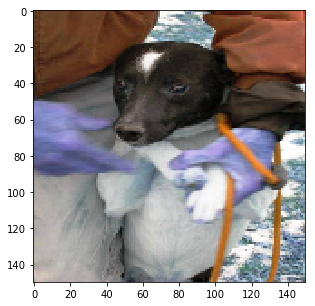



I think this is a CAT with 65.57906% probability


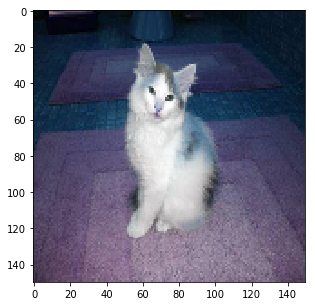



I think this is a CAT with 99.99917% probability


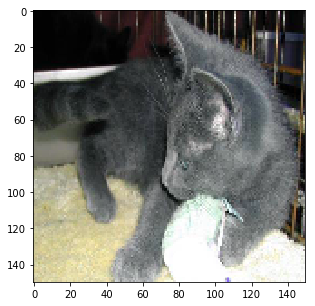



I think this is a CAT with 100.0% probability


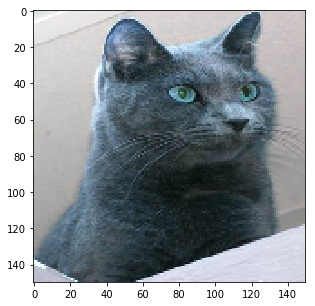



I think this is a DOG with 99.99933% probability


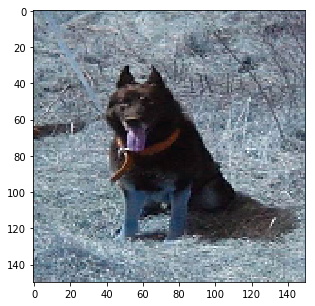



I think this is a CAT with 100.0% probability


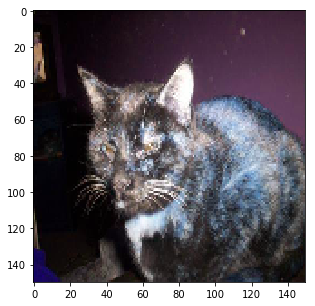



I think this is a CAT with 99.99999% probability


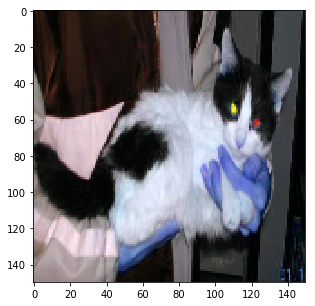



I think this is a CAT with 100.0% probability


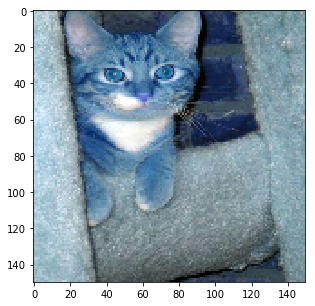



I think this is a CAT with 100.0% probability


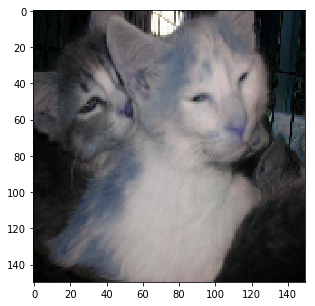



I think this is a DOG with 100.0% probability


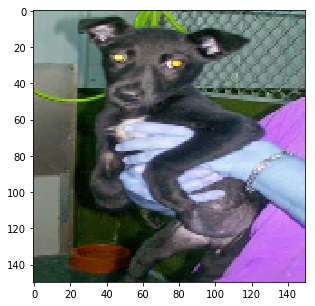



I think this is a DOG with 100.0% probability


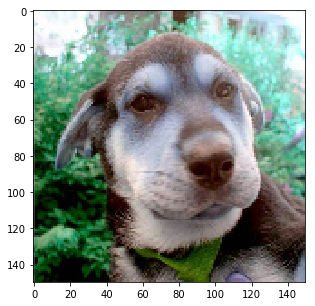



I think this is a CAT with 100.0% probability


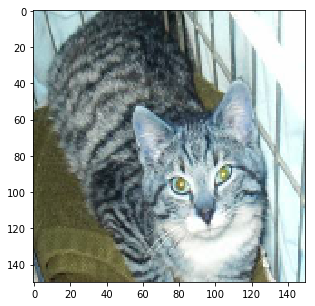



I think this is a DOG with 100.0% probability


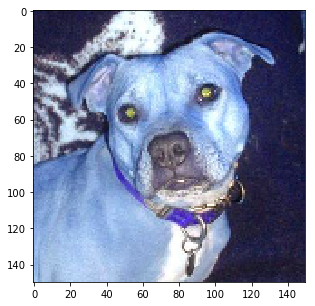



I think this is a CAT with 100.0% probability


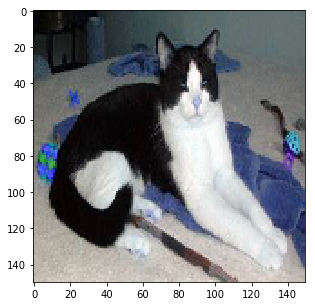



I think this is a DOG with 100.0% probability


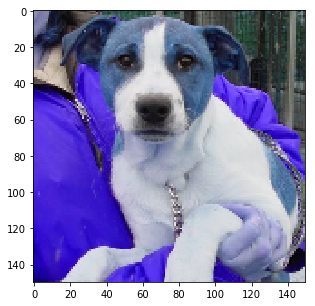



I think this is a CAT with 99.97728% probability


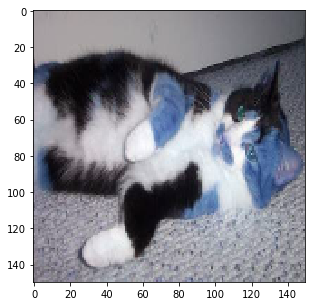



I think this is a DOG with 100.0% probability


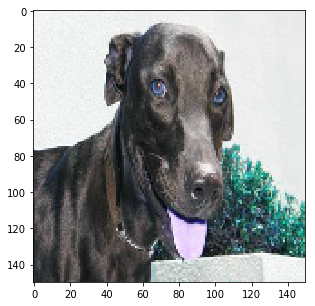



I think this is a DOG with 97.17262% probability


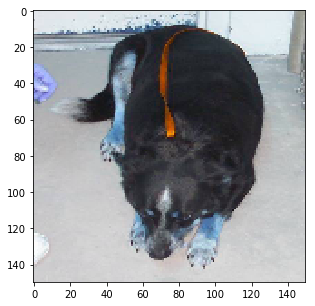



I think this is a CAT with 100.0% probability


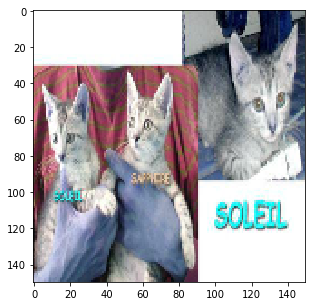



I think this is a DOG with 99.99952% probability


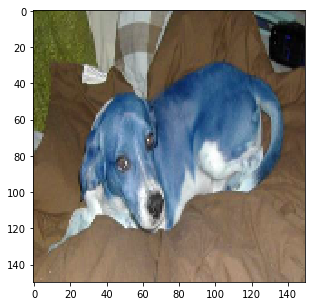



I think this is a DOG with 100.0% probability


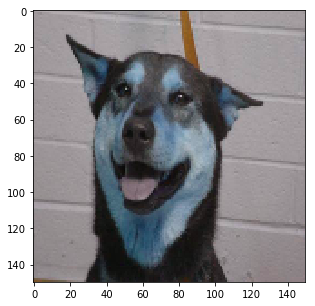



I think this is a CAT with 100.0% probability


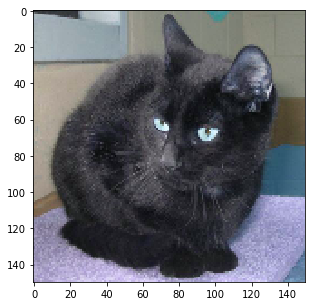



I think this is a DOG with 98.69813% probability


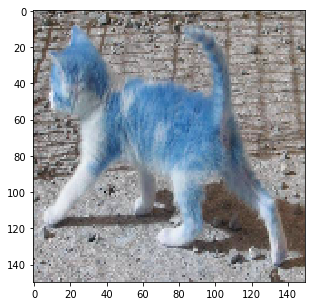



I think this is a DOG with 100.0% probability


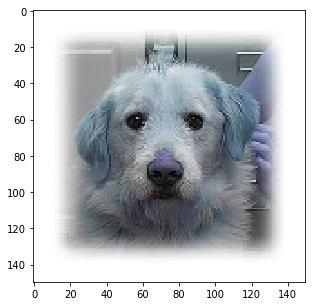



I think this is a DOG with 59.86693% probability


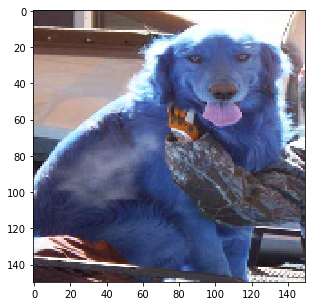



I think this is a DOG with 100.0% probability


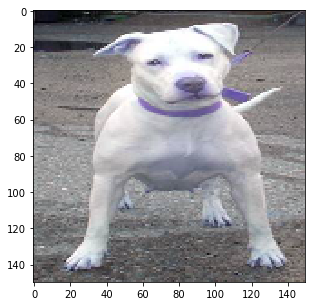



I think this is a CAT with 78.20326% probability


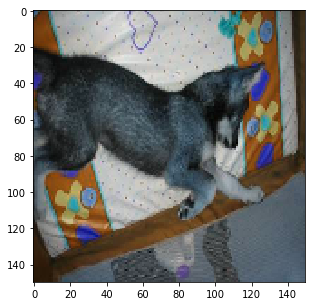



I think this is a DOG with 99.9991% probability


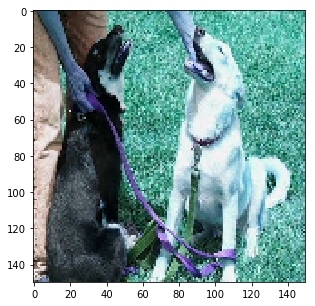



I think this is a CAT with 100.0% probability


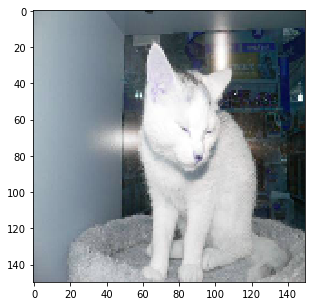



I think this is a CAT with 99.99049% probability


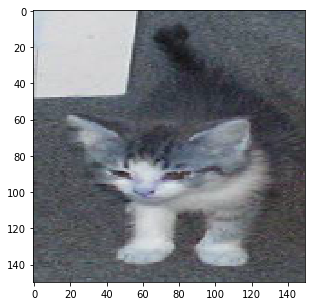



I think this is a CAT with 100.0% probability


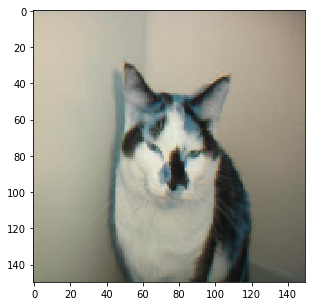



I think this is a CAT with 100.0% probability


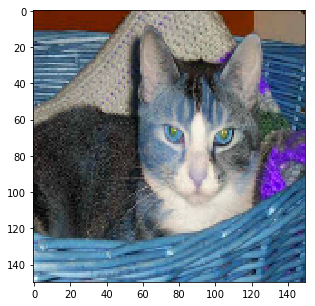



I think this is a CAT with 99.99984% probability


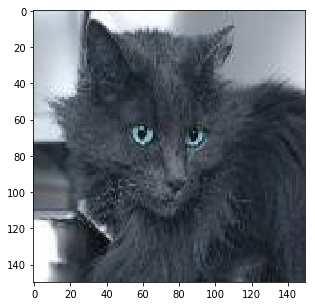



I think this is a DOG with 84.67018% probability


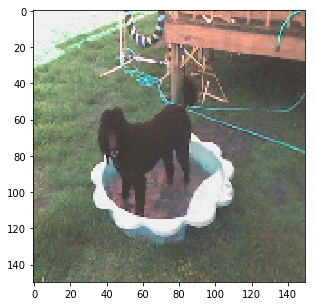



I think this is a DOG with 100.0% probability


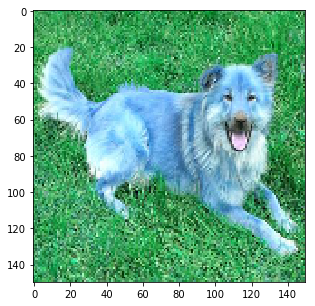



I think this is a CAT with 99.99976% probability


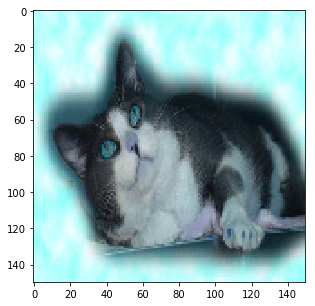



I think this is a DOG with 100.0% probability


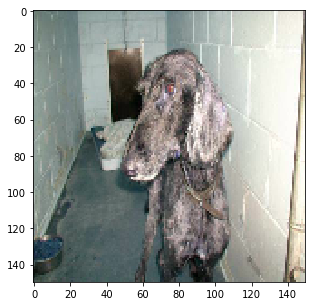



I think this is a DOG with 100.0% probability


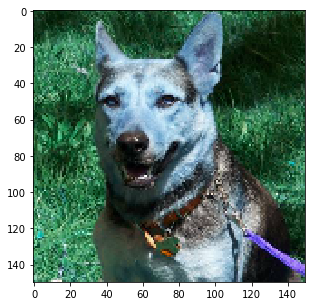



I think this is a DOG with 100.0% probability


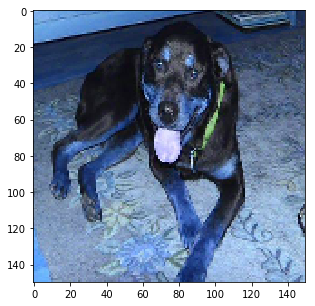



I think this is a DOG with 99.56442% probability


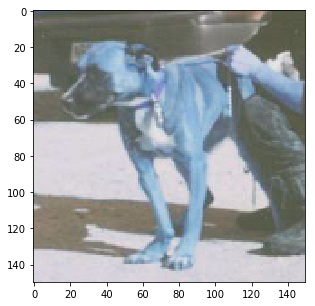



I think this is a CAT with 99.85775% probability


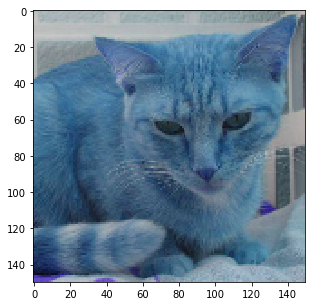



I think this is a CAT with 99.83585% probability


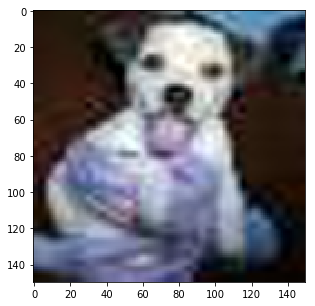



I think this is a CAT with 100.0% probability


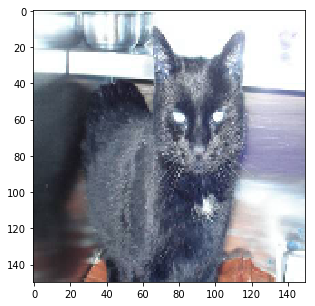



I think this is a DOG with 100.0% probability


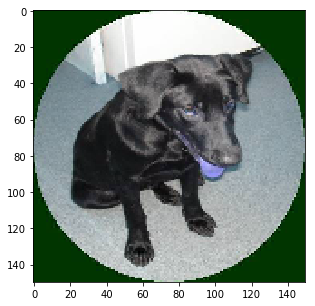



I think this is a DOG with 100.0% probability


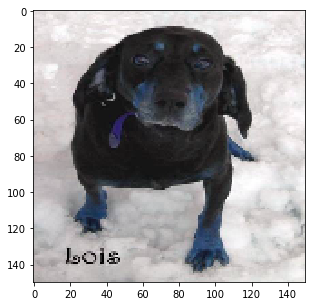



I think this is a CAT with 100.0% probability


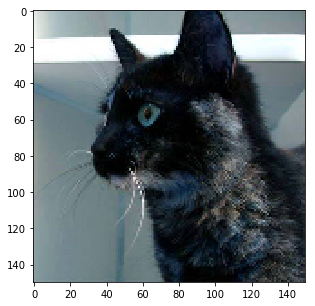



I think this is a CAT with 100.0% probability


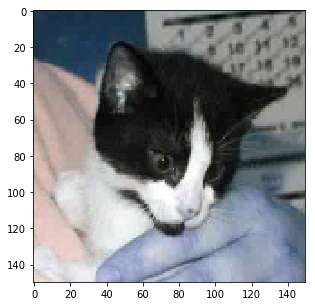



I think this is a CAT with 100.0% probability


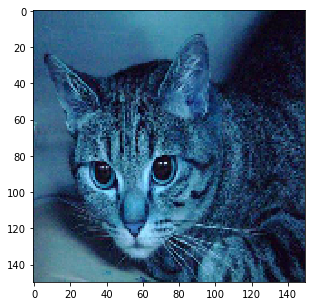



I think this is a CAT with 100.0% probability


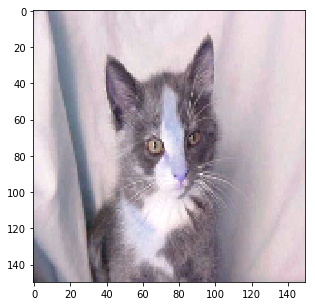



I think this is a CAT with 99.99996% probability


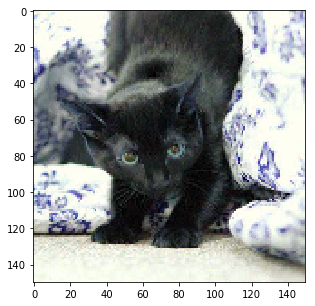



I think this is a CAT with 99.99956% probability


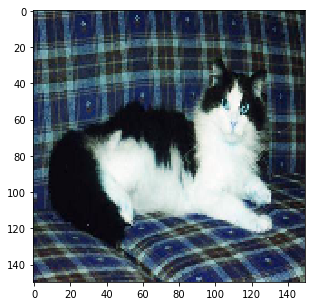



I think this is a CAT with 100.0% probability


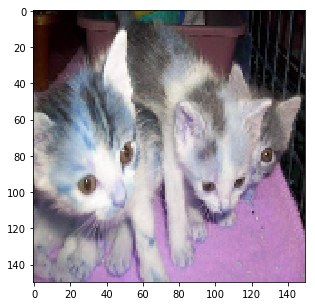



I think this is a DOG with 96.64391% probability


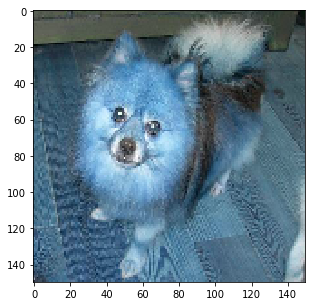



I think this is a DOG with 100.0% probability


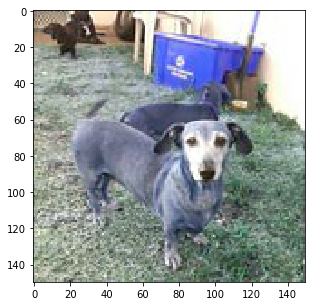



I think this is a CAT with 100.0% probability


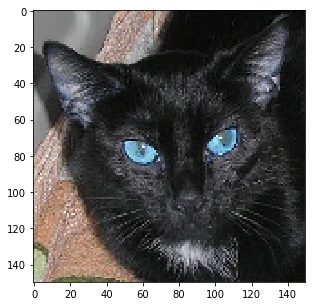



I think this is a DOG with 100.0% probability


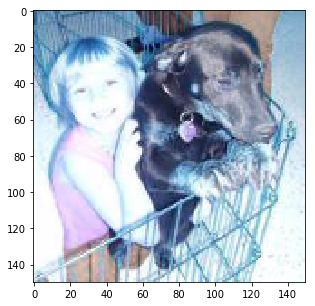



I think this is a CAT with 99.99647% probability


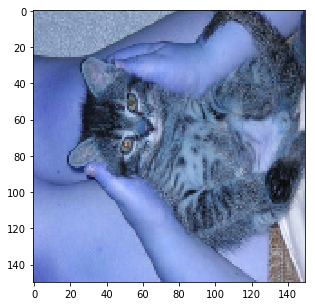



I think this is a CAT with 99.99254% probability


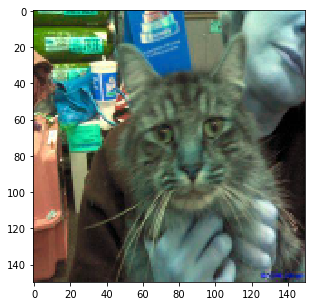



I think this is a CAT with 99.99976% probability


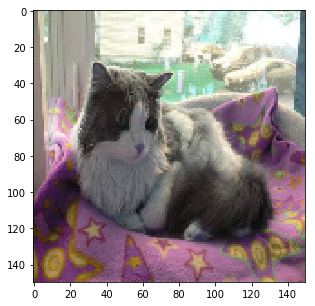



I think this is a CAT with 99.0456% probability


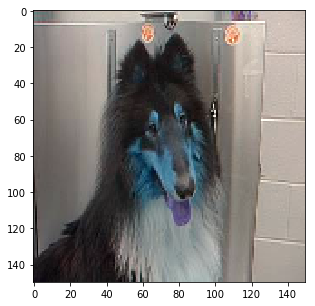



I think this is a CAT with 100.0% probability


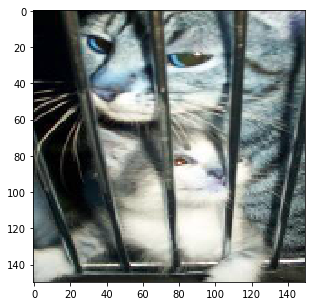



I think this is a DOG with 97.02181% probability


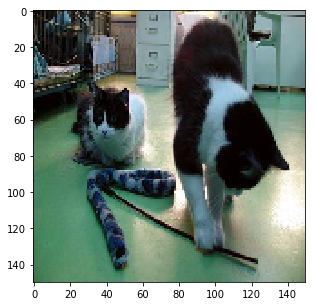



I think this is a DOG with 100.0% probability


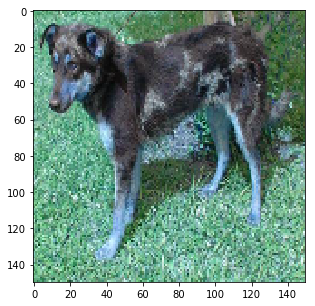



I think this is a DOG with 99.99807% probability


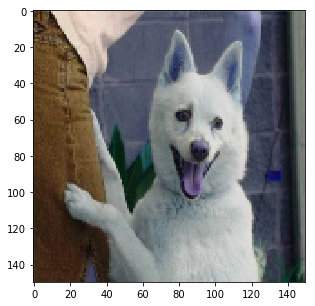



I think this is a DOG with 100.0% probability


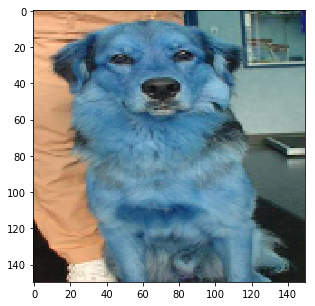



I think this is a CAT with 100.0% probability


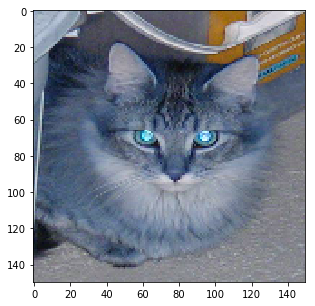



I think this is a DOG with 100.0% probability


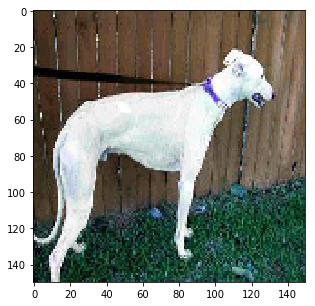



I think this is a CAT with 100.0% probability


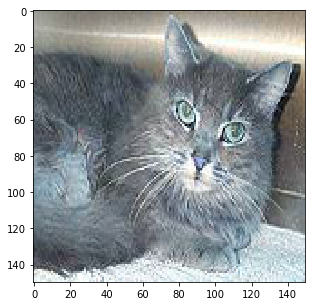



I think this is a DOG with 100.0% probability


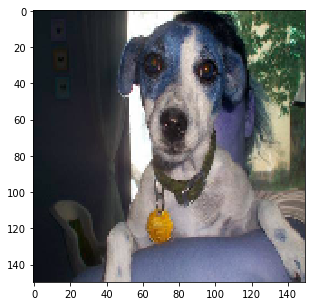



I think this is a DOG with 64.56029% probability


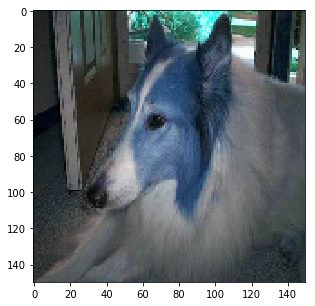



I think this is a DOG with 100.0% probability


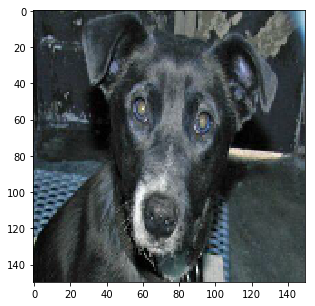



I think this is a DOG with 100.0% probability


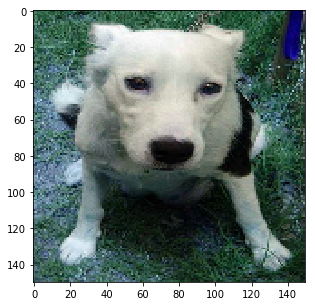



I think this is a DOG with 99.99846% probability


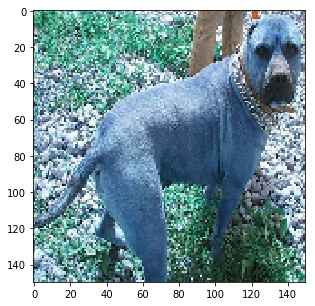



I think this is a DOG with 99.92511% probability


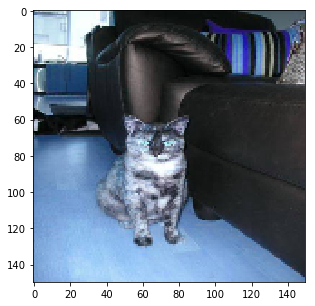



I think this is a DOG with 100.0% probability


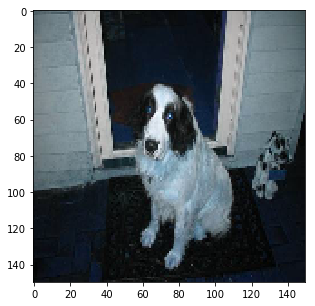



I think this is a DOG with 99.99955% probability


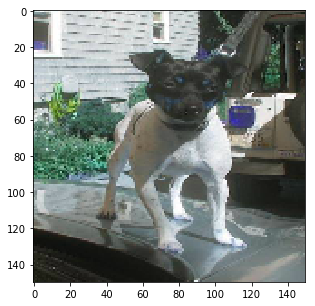



I think this is a DOG with 100.0% probability


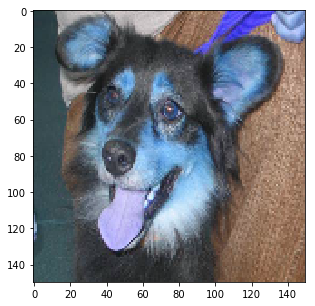



I think this is a DOG with 99.30341% probability


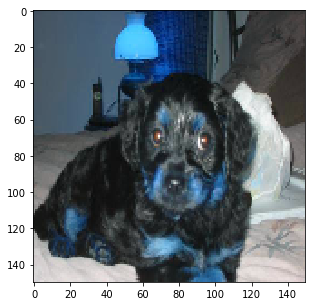



I think this is a CAT with 99.92813% probability


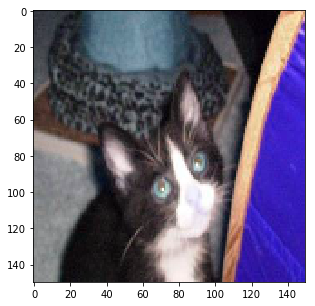



I think this is a CAT with 99.9998% probability


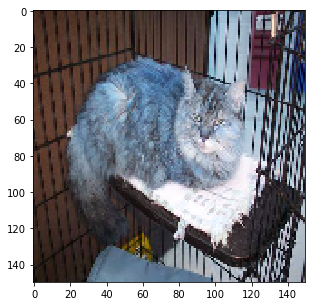



I think this is a CAT with 99.94919% probability


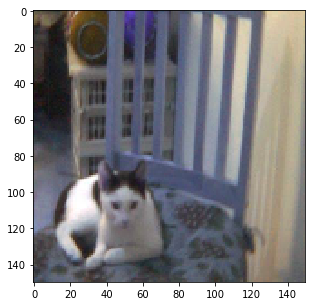



I think this is a CAT with 100.0% probability


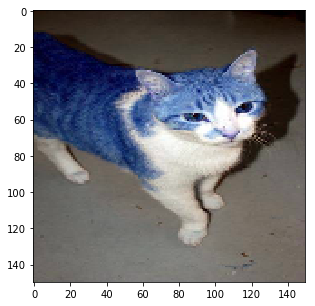



I think this is a DOG with 100.0% probability


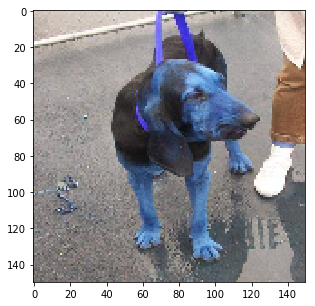



I think this is a CAT with 99.99992% probability


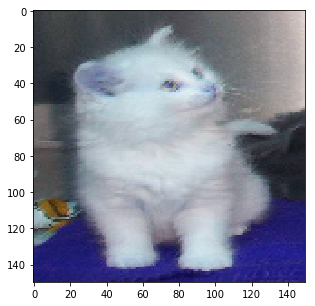



I think this is a DOG with 100.0% probability


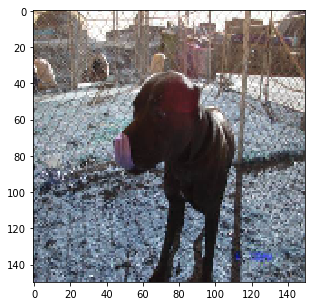



I think this is a CAT with 98.39329% probability


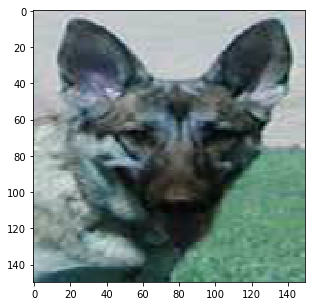



I think this is a DOG with 99.9999% probability


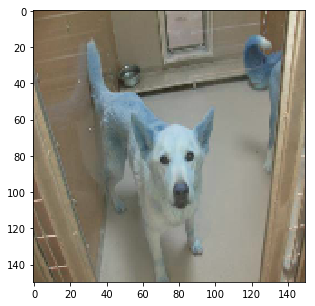



I think this is a DOG with 100.0% probability


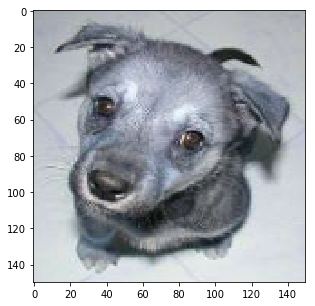



I think this is a CAT with 100.0% probability


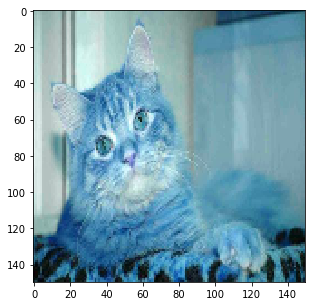



I think this is a CAT with 100.0% probability


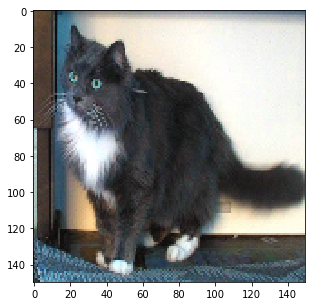



I think this is a CAT with 98.2481% probability


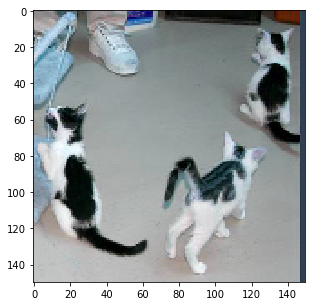



I think this is a CAT with 99.98528% probability


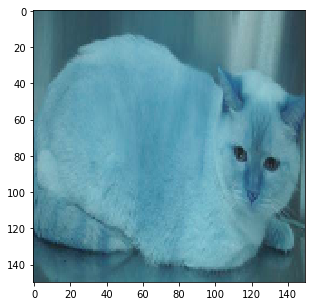



I think this is a CAT with 100.0% probability


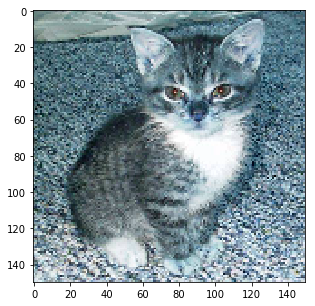



I think this is a CAT with 100.0% probability


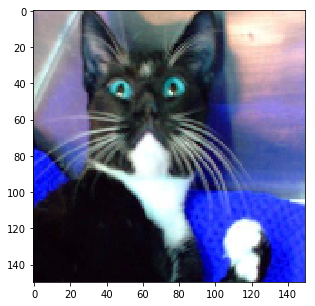



I think this is a DOG with 100.0% probability


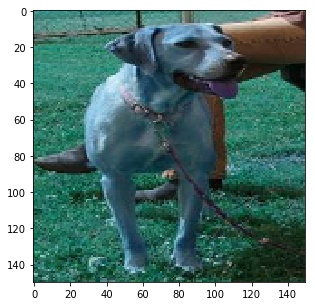



I think this is a DOG with 95.36162% probability


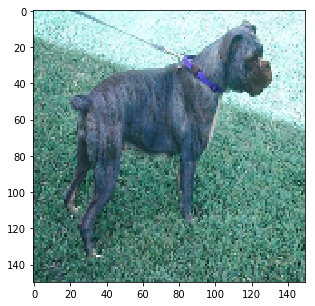



I think this is a CAT with 100.0% probability


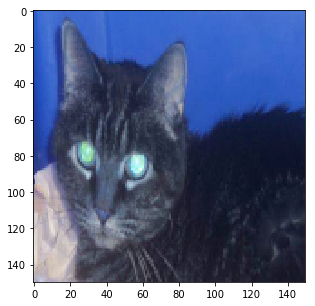



I think this is a DOG with 100.0% probability


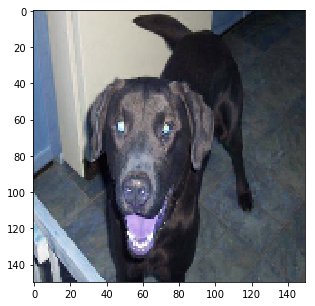



I think this is a DOG with 100.0% probability


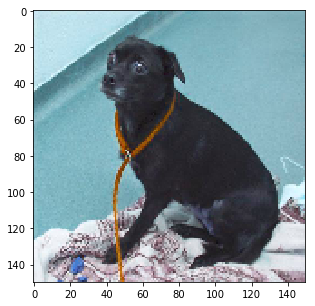



I think this is a CAT with 100.0% probability


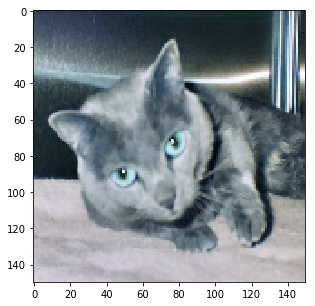

In [45]:
## Answer
import warnings
warnings.filterwarnings('ignore') # filter eventual warning

def predict(mod,i=0,r=None):
    if r==None:
        r=[i]
        
    for idx in r:
        class_pred = mod.predict_classes(test_data,verbose=0)[idx]
        prob_pred = mod.predict_proba(test_data,verbose=0)[idx]
        
        if class_pred ==0:
            prob_pred = 1-prob_pred
            class_guess='CAT'
        else:
            class_guess='DOG'
        
        print('\n\nI think this is a ' + class_guess + ' with ' +str(round(float(prob_pred)*100,5)) + '% probability')
        plot_pic(test_images[idx])

predict(model,r=range(0,len(test_data))) # seems to be doing really well

<a id='sec5'></a>

# Extra credit

Redo the model and pipeline created in Part 1-4 in order to make predictions on the 50 image classes (shown to you during lecture 6). Note that you might have to change how you read in the images, so that when you train the model you do a cross validation split (25 / 75) instead of specifying a specific validation set.  And, you will want to use a `softmax` activation layer instead of a `sigmoid` one (to do multiclass classification).

The data can be downloaded here: https://www.dropbox.com/s/suy8u0hnthwr2su/50_categories.tar.gz?dl=1

Note that you do not have to additional data to make predictions on data not used in the training (however you can easily download 3-5 images like that from Google to try your model).

In [47]:
# Look at files, note all cat images and dog images are unique
for path, dirs, files in os.walk('./50_categories'):
    print('FOLDER',path)
    for f in files[:2]:
        print(f)

FOLDER ./50_categories
.DS_Store
FOLDER ./50_categories/airplanes
airplanes_0001.jpg
airplanes_0002.jpg
FOLDER ./50_categories/bat
bat_0001.jpg
bat_0002.jpg
FOLDER ./50_categories/bear
bear_0001.jpg
bear_0002.jpg
FOLDER ./50_categories/blimp
blimp_0001.jpg
blimp_0002.jpg
FOLDER ./50_categories/camel
camel_0001.jpg
camel_0002.jpg
FOLDER ./50_categories/comet
comet_0001.jpg
comet_0002.jpg
FOLDER ./50_categories/conch
conch_0001.jpg
conch_0002.jpg
FOLDER ./50_categories/cormorant
cormorant_0001.jpg
cormorant_0002.jpg
FOLDER ./50_categories/crab
crab_0001.jpg
crab_0002.jpg
FOLDER ./50_categories/dog
dog_0001.jpg
dog_0002.jpg
FOLDER ./50_categories/dolphin
dolphin_0001.jpg
dolphin_0002.jpg
FOLDER ./50_categories/duck
duck_0001.jpg
duck_0002.jpg
FOLDER ./50_categories/elephant
elephant_0001.jpg
elephant_0002.jpg
FOLDER ./50_categories/elk
elk_0001.jpg
elk_0002.jpg
FOLDER ./50_categories/frog
frog_0001.jpg
frog_0002.jpg
FOLDER ./50_categories/galaxy
galaxy_0001.jpg
galaxy_0002.jpg
FOLDER ./50

In [48]:
categories = next(os.walk('./50_categories'))
print(categories)
categories = categories[1]

('./50_categories', ['airplanes', 'bat', 'bear', 'blimp', 'camel', 'comet', 'conch', 'cormorant', 'crab', 'dog', 'dolphin', 'duck', 'elephant', 'elk', 'frog', 'galaxy', 'giraffe', 'goat', 'goldfish', 'goose', 'gorilla', 'helicopter', 'horse', 'hot-air-balloon', 'hummingbird', 'iguana', 'kangaroo', 'killer-whale', 'leopards', 'llama', 'mars', 'mussels', 'octopus', 'ostrich', 'owl', 'penguin', 'porcupine', 'raccoon', 'saturn', 'skunk', 'snail', 'snake', 'speed-boat', 'starfish', 'swan', 'teddy-bear', 'toad', 'triceratops', 'unicorn', 'zebra'], ['.DS_Store'])


In [49]:
# Map categories to an integer
cat_dic = dict()
for idx, cat in enumerate(categories):
    cat_dic[cat] = idx


In [50]:
print(cat_dic)

{'starfish': 43, 'camel': 4, 'elk': 13, 'bear': 2, 'porcupine': 36, 'helicopter': 21, 'conch': 6, 'octopus': 32, 'zebra': 49, 'dog': 9, 'snake': 41, 'airplanes': 0, 'kangaroo': 26, 'penguin': 35, 'unicorn': 48, 'duck': 11, 'ostrich': 33, 'mars': 30, 'goat': 17, 'teddy-bear': 45, 'galaxy': 15, 'owl': 34, 'hummingbird': 24, 'iguana': 25, 'raccoon': 37, 'crab': 8, 'hot-air-balloon': 23, 'triceratops': 47, 'swan': 44, 'frog': 14, 'dolphin': 10, 'gorilla': 20, 'leopards': 28, 'killer-whale': 27, 'goldfish': 18, 'saturn': 38, 'comet': 5, 'skunk': 39, 'toad': 46, 'llama': 29, 'cormorant': 7, 'elephant': 12, 'speed-boat': 42, 'giraffe': 16, 'bat': 1, 'horse': 22, 'snail': 40, 'goose': 19, 'mussels': 31, 'blimp': 3}


In [51]:
n_imgs = 0
for cat in categories:
    nbr_cat_imgs = len(next(os.walk('./50_categories/'+cat))[2])
    print('Number of '+cat+' images:', nbr_cat_imgs)
    n_imgs+=nbr_cat_imgs

Number of airplanes images: 533
Number of bat images: 71
Number of bear images: 68
Number of blimp images: 57
Number of camel images: 73
Number of comet images: 81
Number of conch images: 69
Number of cormorant images: 71
Number of crab images: 57
Number of dog images: 68
Number of dolphin images: 71
Number of duck images: 58
Number of elephant images: 87
Number of elk images: 67
Number of frog images: 77
Number of galaxy images: 54
Number of giraffe images: 56
Number of goat images: 75
Number of goldfish images: 62
Number of goose images: 73
Number of gorilla images: 141
Number of helicopter images: 59
Number of horse images: 180
Number of hot-air-balloon images: 59
Number of hummingbird images: 77
Number of iguana images: 71
Number of kangaroo images: 55
Number of killer-whale images: 61
Number of leopards images: 127
Number of llama images: 79
Number of mars images: 104
Number of mussels images: 116
Number of octopus images: 74
Number of ostrich images: 73
Number of owl images: 80
N

In [52]:
n_imgs

4244

In [53]:
from glob import glob
len(glob("./50_categories/*/*.jpg")) #4244 images

4244

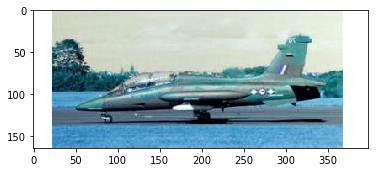

In [54]:
# plot with opencv
img = cv2.imread('./50_categories/airplanes/airplanes_0001.jpg')
img.shape
plt.imshow(img)

In [55]:
path_all_images = glob("./50_categories/*/*.jpg")
path_all_images[0:10]

['./50_categories/airplanes/airplanes_0001.jpg',
 './50_categories/airplanes/airplanes_0002.jpg',
 './50_categories/airplanes/airplanes_0003.jpg',
 './50_categories/airplanes/airplanes_0004.jpg',
 './50_categories/airplanes/airplanes_0005.jpg',
 './50_categories/airplanes/airplanes_0006.jpg',
 './50_categories/airplanes/airplanes_0007.jpg',
 './50_categories/airplanes/airplanes_0008.jpg',
 './50_categories/airplanes/airplanes_0009.jpg',
 './50_categories/airplanes/airplanes_0010.jpg']

In [56]:
def get_image_categories(images):
    """Get the true categories of a set of paths to images, based on the
    directory they are located in.

    The paths should have the form:
        path/to/image/category/image.jpg

    Where the image filename is the last item in the path, and the
    directory (category name) is the second to last item in the path.

    Parameters
    ----------
    images : list
        List of paths to images

    Returns
    -------
    categories : numpy.ndarray
        An array of integers in order of the images, corresponding to
        each image's category
    category_map : list
        A list of category names. The category integers in
        `categories` are indices into this list.

    """
    get_category = lambda x: os.path.split(os.path.split(x)[0])[1]
    categories = list(map(get_category, images))
    category_map = sorted(set(categories))
    categories = np.array(map(category_map.index, categories))
    return categories, category_map



In [57]:
img_cats, img_cat_map = get_image_categories(path_all_images)

In [58]:
img_cat_map[0:3]

['airplanes', 'bat', 'bear']

In [59]:
# Define variables
DATA_DIR = './50_categories/'

img_width, img_height = 150, 150

n_samples = n_imgs
n_epoch = 40

In [19]:
#  Run model once to record the bottleneck features using image data generators:
#  Note: This can take a lot of time

def save_bottleneck_features():

    # build the VGG16 network
    model = Sequential()
    model.add(ZeroPadding2D((1, 1), input_shape=(3, img_width, img_height)))

    model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_2'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_2'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_2'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_3'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_2'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_3'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_1'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_2'))
    model.add(ZeroPadding2D((1, 1)))
    model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_3'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2)))

    # load the weights of the VGG16 networks
    # note: when there is a complete match between your model definition
    # and your weight savefile, you can simply call model.load_weights(filename)
    assert os.path.exists('vgg16_weights.h5'), 'Model weights not found (Download file vgg16_weights.h5 from bcourses).'
    f = h5py.File('vgg16_weights.h5')
    for k in range(f.attrs['nb_layers']):
        if k >= len(model.layers):
            # we don't look at the last (fully-connected) layers in the savefile
            break
        g = f['layer_{}'.format(k)]
        weights = [g['param_{}'.format(p)] for p in range(g.attrs['nb_params'])]
        model.layers[k].set_weights(weights)
    f.close()
    print('Model loaded.')

    
    # Rescale value we multiply the data before any other processing. 
    # Our original images consist in RGB coefficients in the 0-255, 
    # but such values would be too high for our models to process (given typical learning rate), 
    # so we target values between 0 and 1 instead by scaling with a 1/255. factor.
    datagen = ImageDataGenerator(rescale=1./255)
    
    def generate_features(DIR,n_samples,name_str):
        '''
        This is a generator that will read pictures found in
        subfolers of 'data/*', and indefinitely generate
        batches of image rescaled images used to predict
        the bottleneck features of the images once
        using model.predict_generator(**args**)
       '''
        print('Generate '+name_str+' image features')

        generator = datagen.flow_from_directory(
            DIR,
            target_size=(img_width, img_height),
            batch_size=32,
            class_mode=None, # this means our generator will only yield batches of data, no labels
            shuffle=False)  # our data will be in order, so all first 1000 images will be cats, then 1000 dogs

        
        features = model.predict_generator(generator, n_samples)
        # the predict_generator method returns the output of a model, given
        # a generator that yields batches of numpy data
        
        np.save(open('50_classes_features.npy', 'w'), features) # save bottleneck features to file
        
    generate_features(DATA_DIR, n_samples, 'data')


    
save_bottleneck_features()


''

In [60]:
# Obtain image labels and binary classification
datagen = ImageDataGenerator(rescale=1./255)
class_gen = datagen.flow_from_directory(DATA_DIR,target_size=(img_width, img_height),
                                        batch_size=32,class_mode=None,shuffle=False)

class_labels = class_gen.classes

print('\nClassifications:\n',class_gen.class_indices)
print('\nClass labels:\n',class_labels)

print(class_gen.class_indices.keys() == cat_dic.keys())

Found 4244 images belonging to 50 classes.

Classifications:
 {'starfish': 43, 'camel': 4, 'elk': 13, 'bear': 2, 'porcupine': 36, 'helicopter': 21, 'conch': 6, 'octopus': 32, 'zebra': 49, 'dog': 9, 'snake': 41, 'airplanes': 0, 'kangaroo': 26, 'penguin': 35, 'unicorn': 48, 'duck': 11, 'ostrich': 33, 'mars': 30, 'goat': 17, 'teddy-bear': 45, 'galaxy': 15, 'owl': 34, 'hummingbird': 24, 'iguana': 25, 'raccoon': 37, 'crab': 8, 'hot-air-balloon': 23, 'triceratops': 47, 'swan': 44, 'frog': 14, 'dolphin': 10, 'gorilla': 20, 'leopards': 28, 'killer-whale': 27, 'goldfish': 18, 'saturn': 38, 'comet': 5, 'skunk': 39, 'toad': 46, 'llama': 29, 'cormorant': 7, 'elephant': 12, 'speed-boat': 42, 'giraffe': 16, 'bat': 1, 'horse': 22, 'snail': 40, 'goose': 19, 'mussels': 31, 'blimp': 3}

Class labels:
 [ 0  0  0 ..., 49 49 49]
True


In [44]:
# since all of our features are stored in order
# and we have not split up our training data into training and validation folders
# in order to not only train on the first classes we need to randomize our samples
# this can easily be done with scikit-learn's test_train_split module

# we train on the X_train and y_train sets
# then we evaluate our model on the X_test and y_test sets

from sklearn.model_selection import train_test_split
class_data = np.load('50_classes_features.npy') # load in bottleneck features
print(class_data.shape)
X_train, X_test, y_train, y_test, path_train, path_test = train_test_split(class_data, class_labels, path_all_images,\
                                                                           test_size=0.2, random_state=150)
print(X_train.shape)

(4244, 512, 4, 4)
(3395, 512, 4, 4)


In [54]:
print(path_train[0:4])
print([img_cat_map[i] for i in y_train[0:4]]) # the img_paths have been mapped correctly

['./50_categories/speed-boat/speed-boat_0024.jpg', './50_categories/dog/dog_0062.jpg', './50_categories/octopus/octopus_0020.jpg', './50_categories/llama/llama_0066.jpg']
['speed-boat', 'dog', 'octopus', 'llama']


In [55]:
# Load in bottleneck features
# Run the code below to train your CNN with the training data
from keras.optimizers import SGD



# the features were saved in order, so recreating the labels is easy


# Add top layers trained ontop of extracted VGG features
# Small fully connected model trained on top of the stored features
model = Sequential()
model.add(Flatten(input_shape=class_data.shape[1:]))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(50, activation='softmax'))
#model.add(Dense(4096, activation='relu'))
#model.add(Dropout(0.5))
#model.add(Dense(4096, activation='relu'))
#model.add(Dropout(0.5))
#model.add(Dense(50, activation='softmax'))

    
sgd = SGD(lr=0.01)
model.compile(optimizer=sgd, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.fit(X_train, y_train, batch_size=32, nb_epoch=40,validation_split=0, verbose=1) # we don't need a validation split
print('Done!')

Epoch 1/40
3395/3395 [==============================] - 0s - loss: 3.6417 - acc: 0.1426         

In [56]:

val_pred_class = model.predict_classes(X_test,verbose=1)
#val_pred_prob = model.predict_proba(class_data,verbose=0)

print(model.evaluate(X_test,y_test,verbose=0))
# First number is validation loss, loss of the objective function
# Second number validation accuracy

608/849 [====================>.........] - ETA: 0s[1.5108335189459883, 0.57597173179979178]


In [58]:
print(np.unique(val_pred_class)) #ok 50 classes in our prediction

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49]


In [60]:
np.sum(val_pred_class==y_test)/len(y_test) # ~60% accuracy

0.57597173144876324

In [61]:
print(model.evaluate(X_test,y_test,verbose=0))

[1.5108335189459883, 0.57597173179979178]


In [ ]:
print(DATA_DIR)

In [74]:
def read_image(file_path):
    # For image visualization
    img = cv2.imread(file_path, cv2.IMREAD_COLOR) #cv2.IMREAD_GRAYSCALE
    #return cv2.resize(img, (img_height, img_width), interpolation=cv2.INTER_CUBIC)
    return img

def plot_pic(img):
    # Plot openCV pic
    pic = read_image(img)    
    plt.figure(figsize=(5,5))
    plt.imshow(pic)
    plt.show()

In [77]:
#alternative plotpic function
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_pic(img):
    image = mpimg.imread(img)
    plt.figure(figsize=(9,9))
    plt.imshow(image)
    plt.grid(False)
    plt.show()



Probable category: zebra


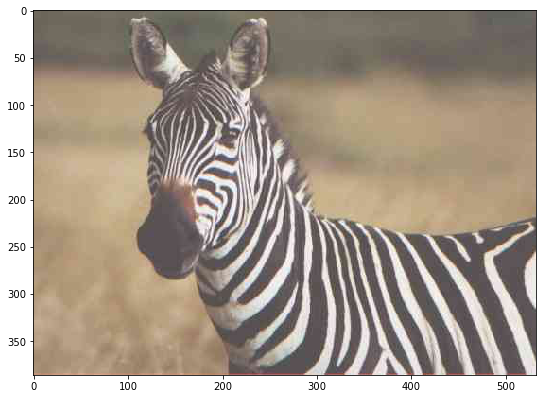



Probable category: killer-whale


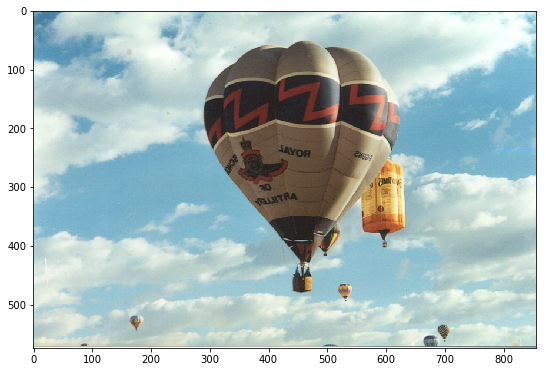



Probable category: airplanes


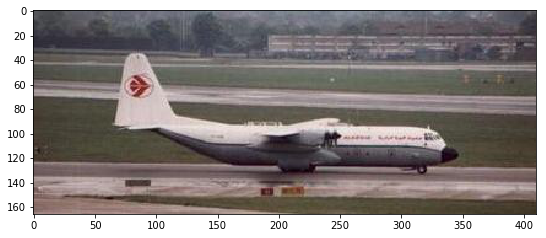



Probable category: unicorn


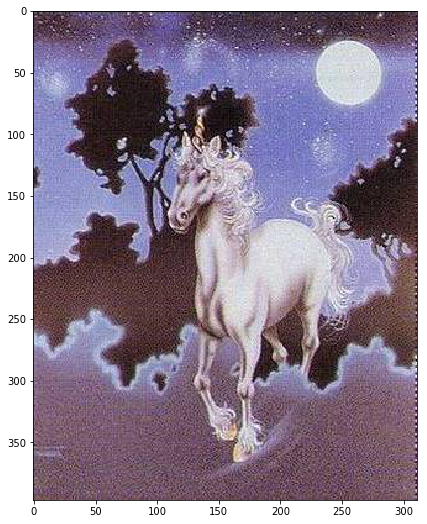



Probable category: airplanes


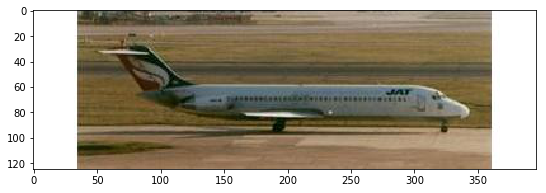



Probable category: galaxy


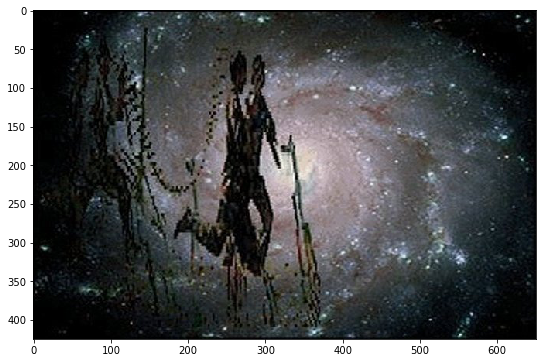



Probable category: goose


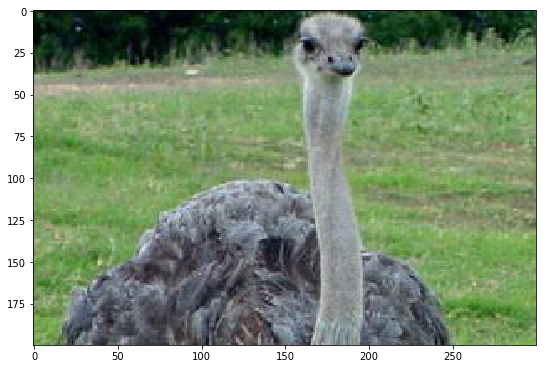



Probable category: mars


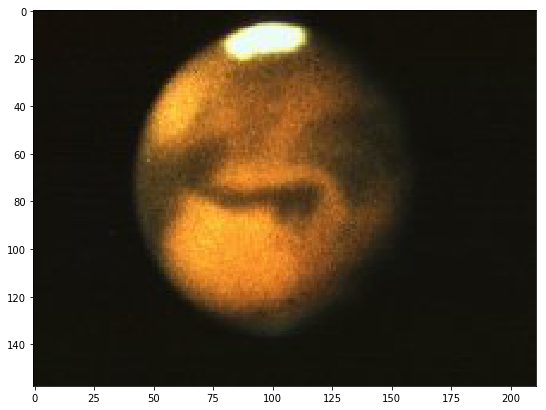



Probable category: skunk


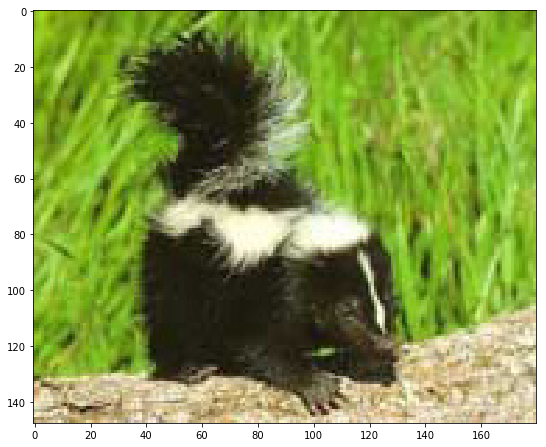



Probable category: comet


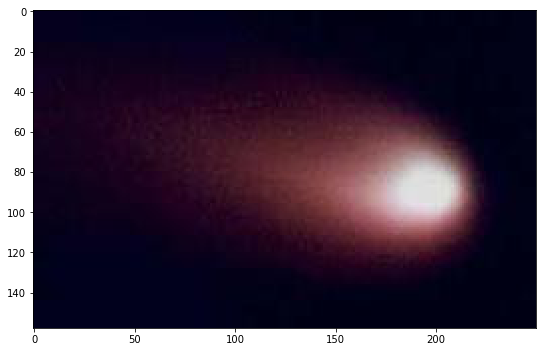



Probable category: elephant


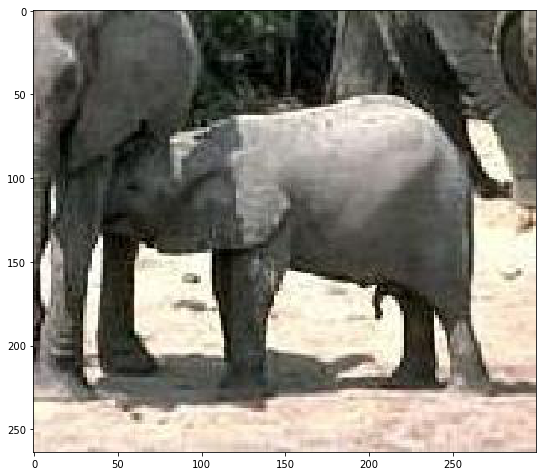



Probable category: airplanes


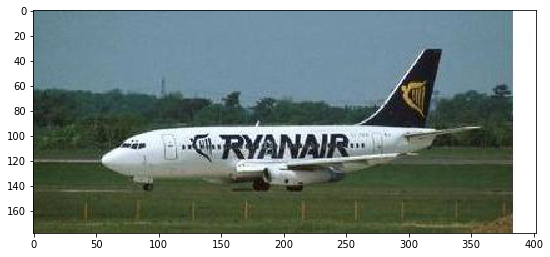



Probable category: llama


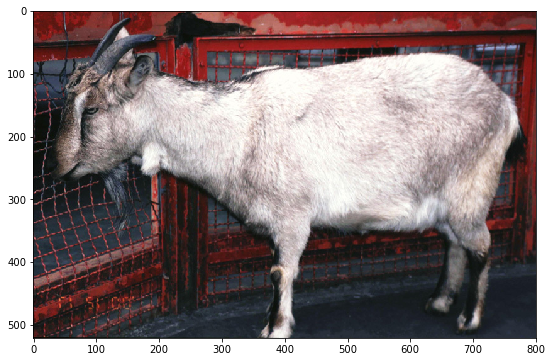



Probable category: teddy-bear


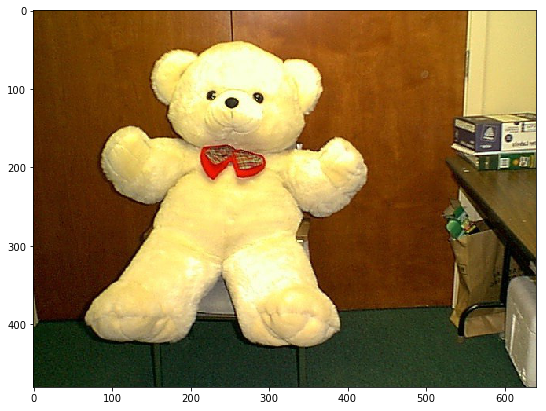



Probable category: duck


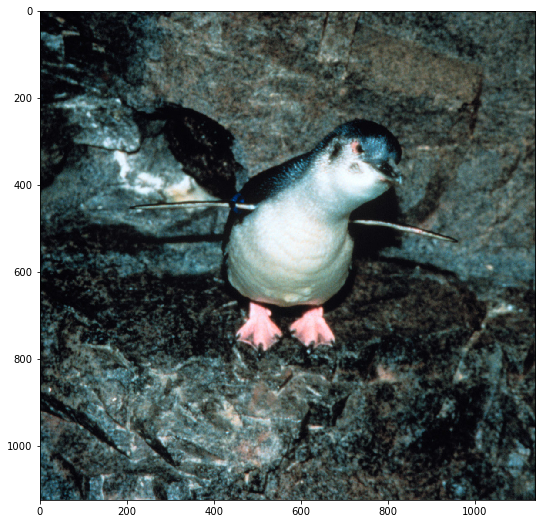



Probable category: snake


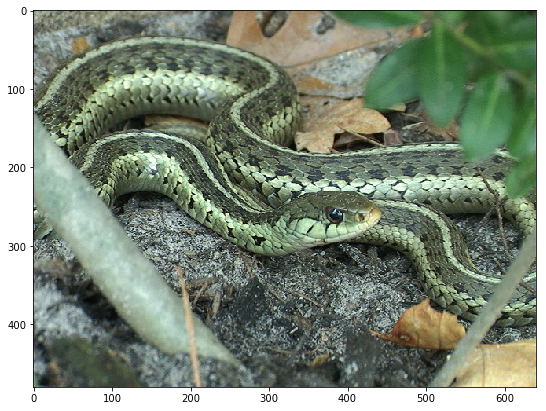



Probable category: raccoon


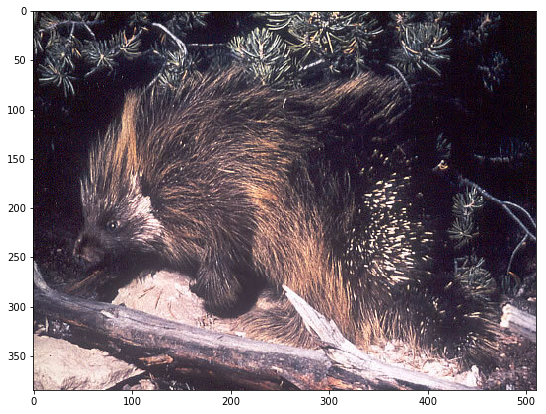



Probable category: llama


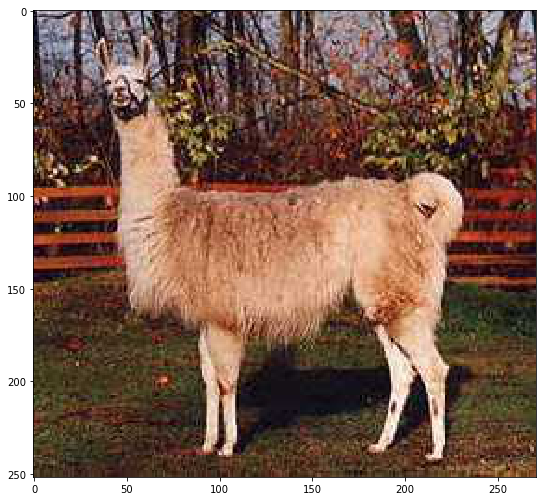



Probable category: iguana


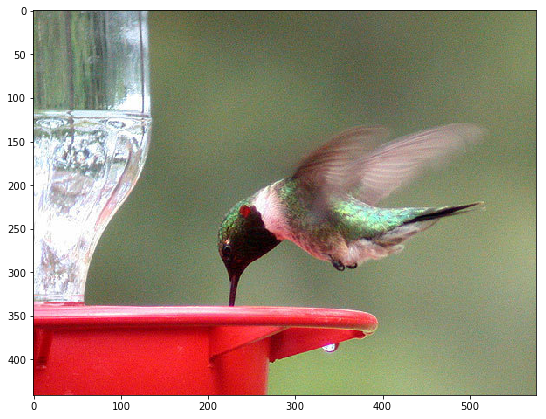



Probable category: cormorant


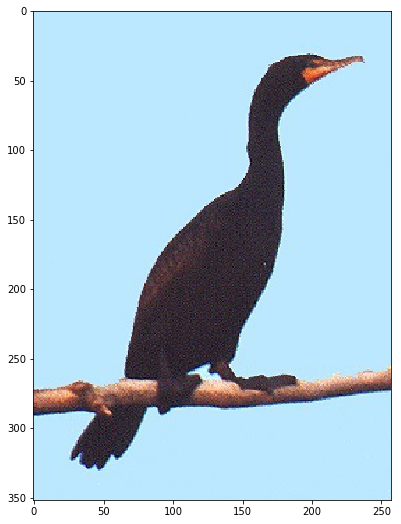



Probable category: airplanes


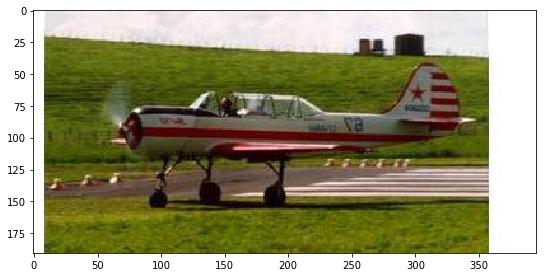



Probable category: frog


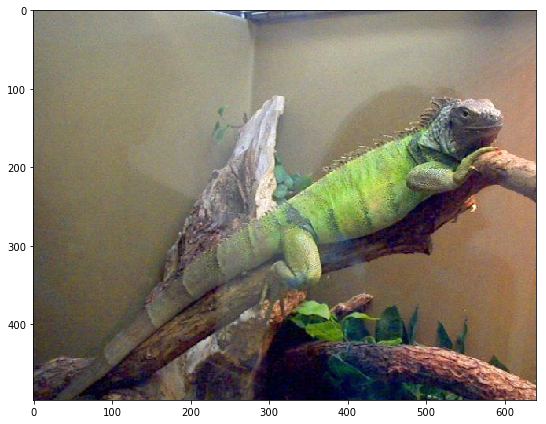



Probable category: hummingbird


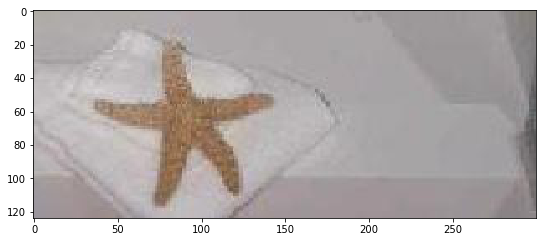



Probable category: gorilla


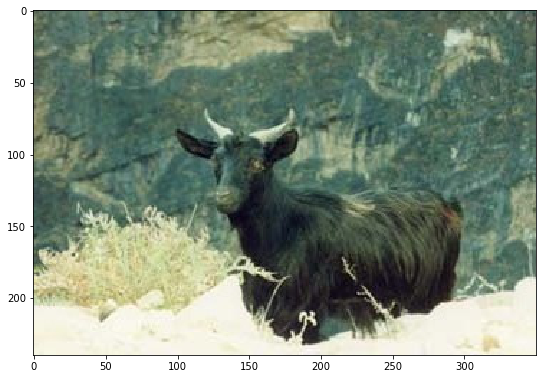



Probable category: airplanes


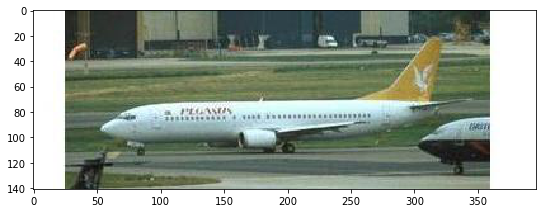



Probable category: bat


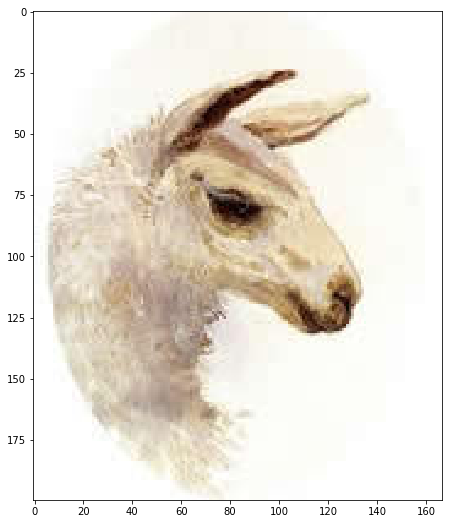



Probable category: speed-boat


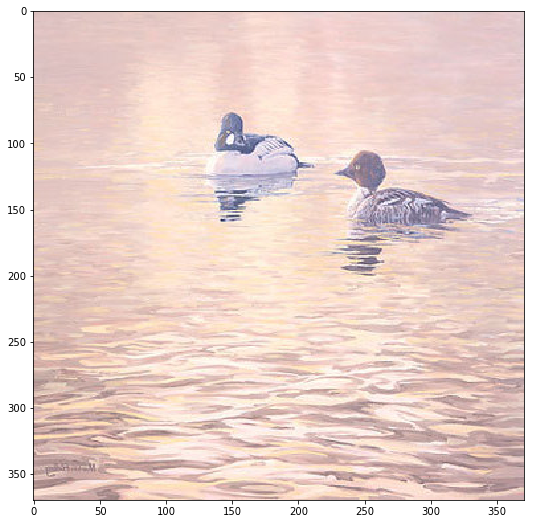



Probable category: gorilla


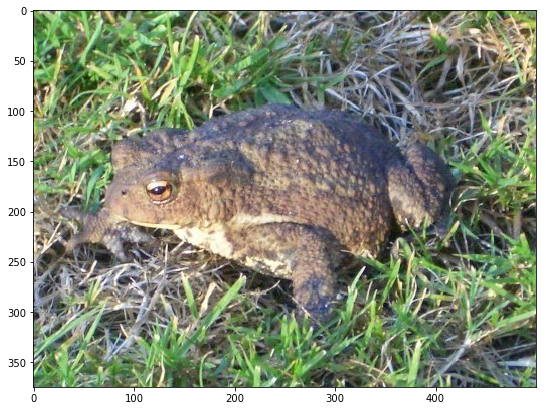



Probable category: horse


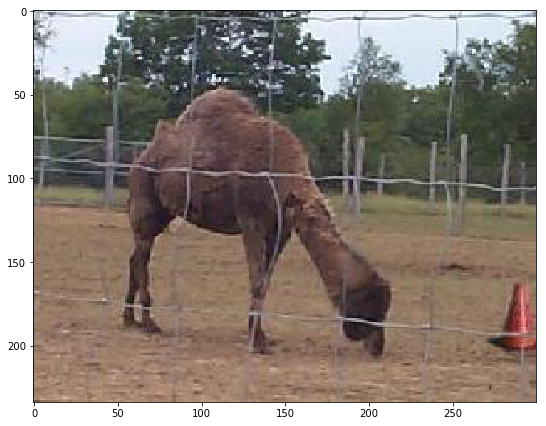



Probable category: kangaroo


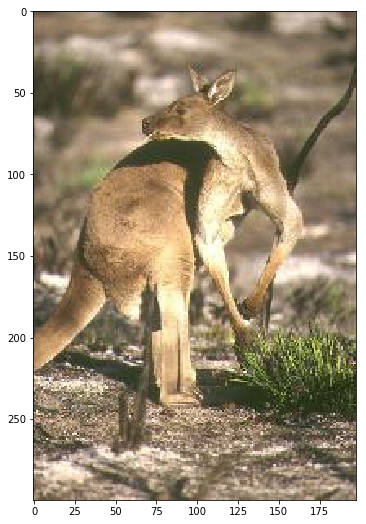



Probable category: swan


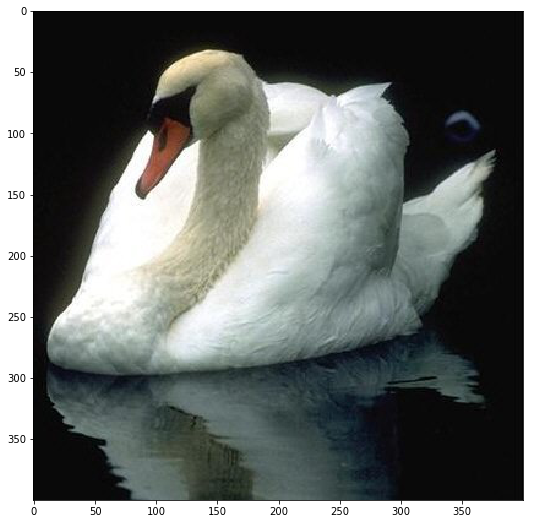



Probable category: gorilla


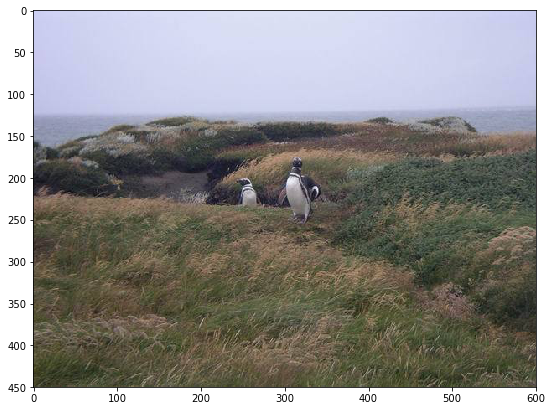



Probable category: airplanes


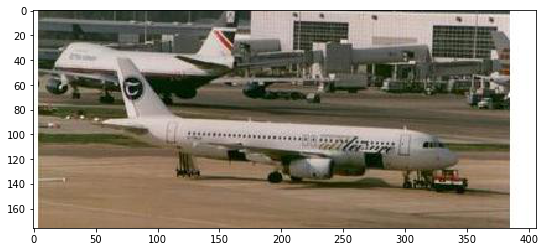



Probable category: hot-air-balloon


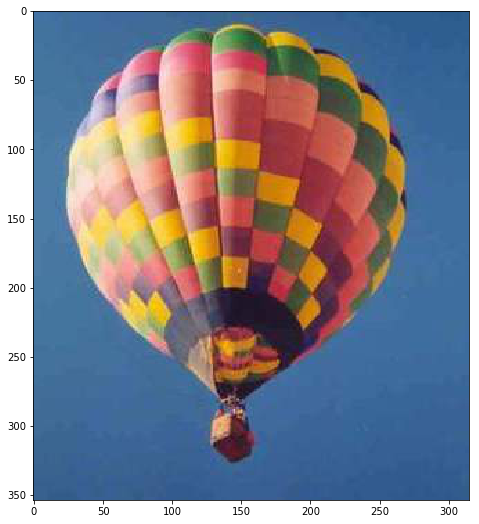



Probable category: llama


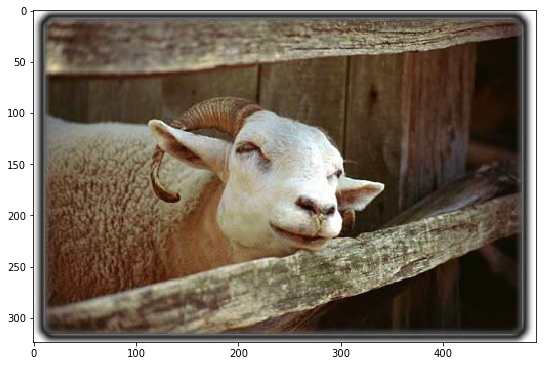



Probable category: leopards


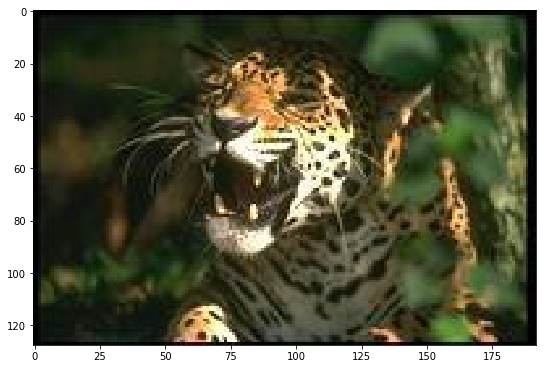



Probable category: goat


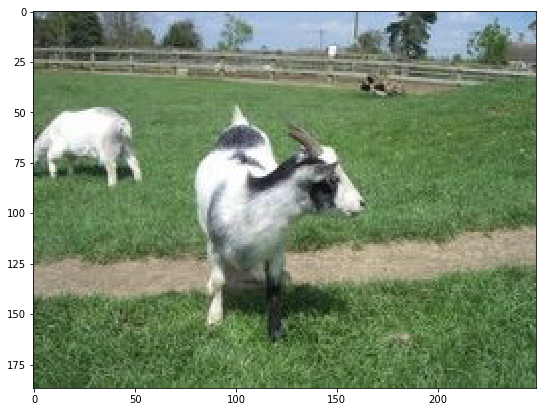



Probable category: killer-whale


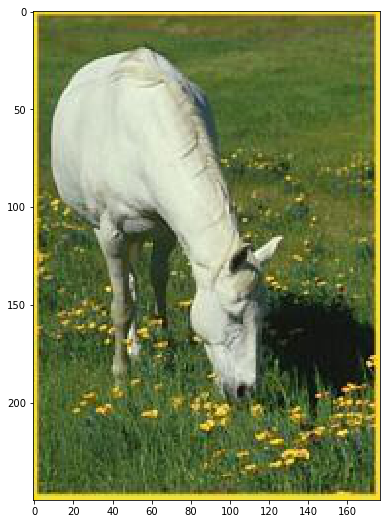



Probable category: duck


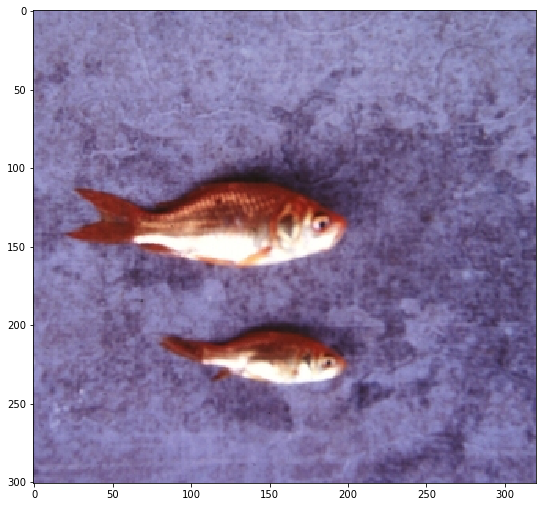



Probable category: goat


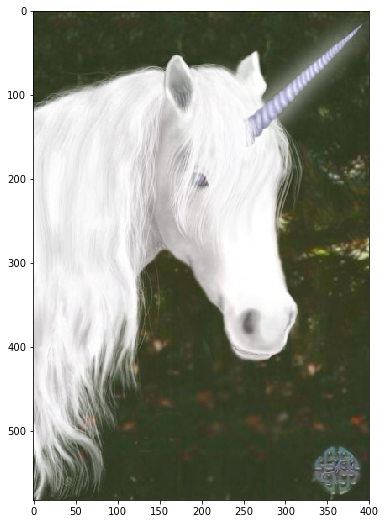



Probable category: duck


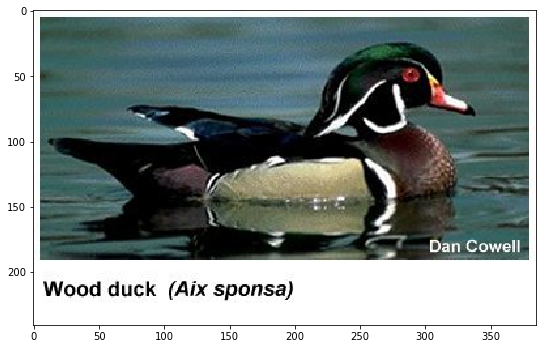



Probable category: swan


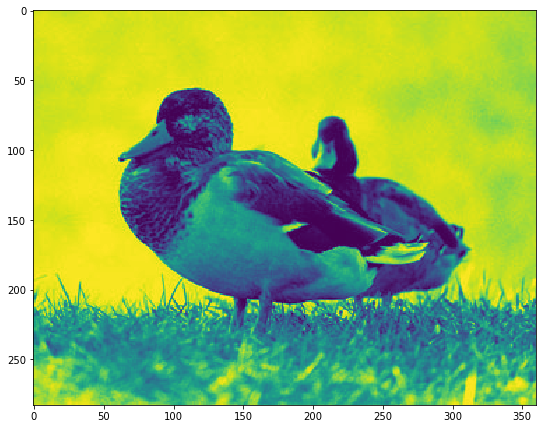



Probable category: gorilla


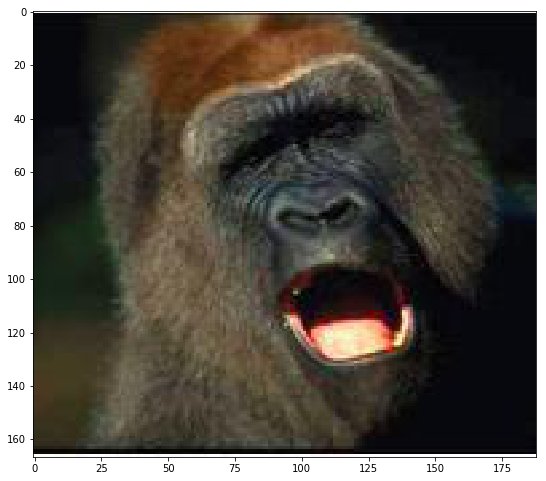



Probable category: airplanes


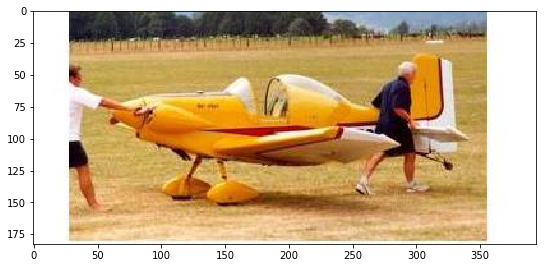



Probable category: raccoon


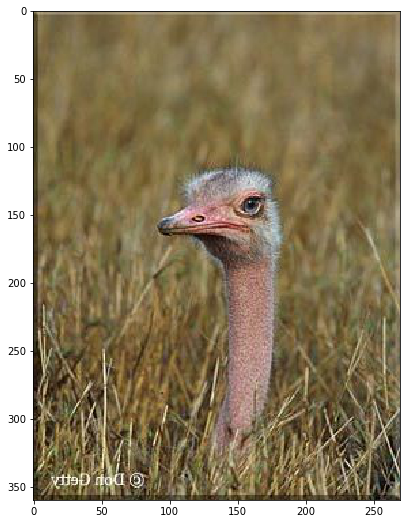



Probable category: frog


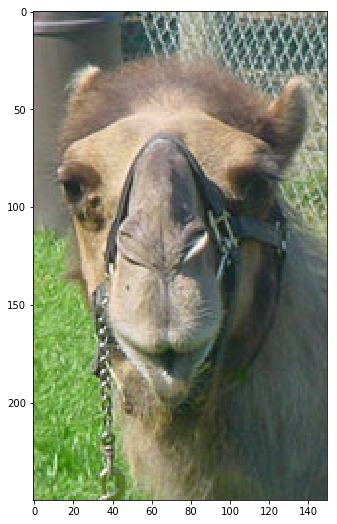



Probable category: owl


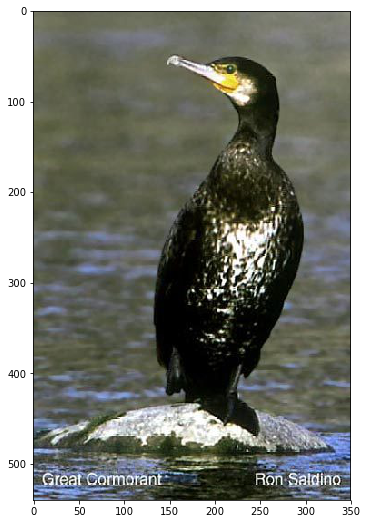



Probable category: airplanes


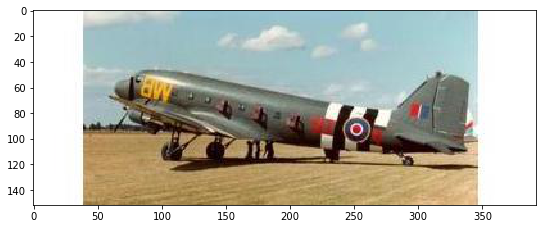



Probable category: saturn


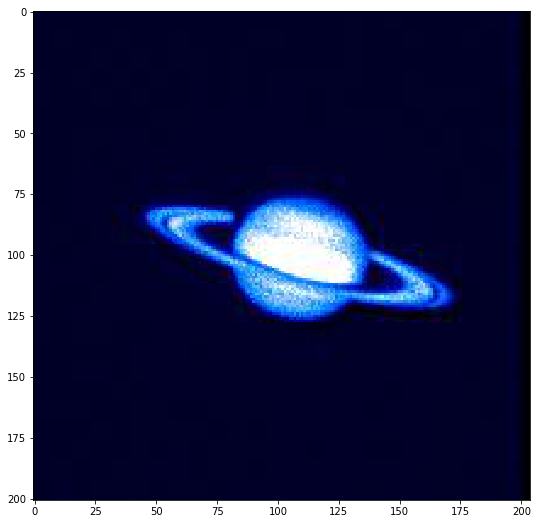



Probable category: octopus


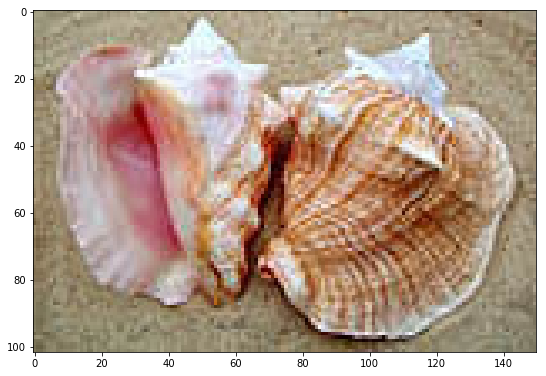



Probable category: raccoon


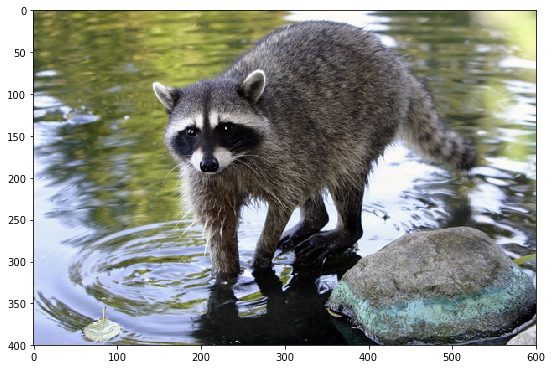



Probable category: octopus


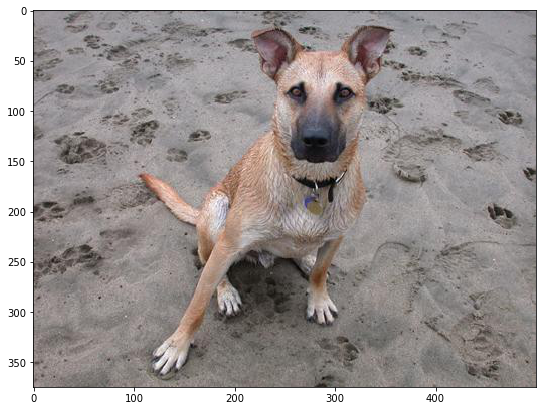



Probable category: goat


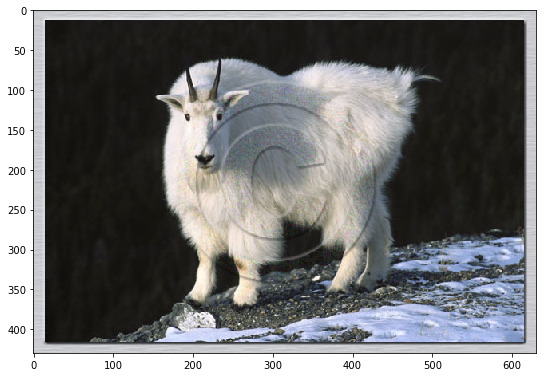



Probable category: starfish


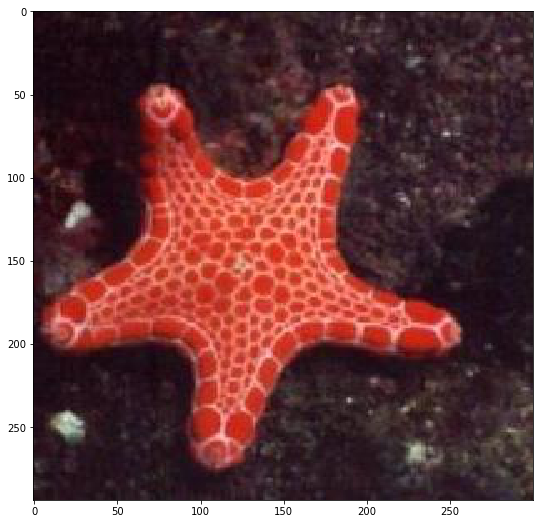



Probable category: leopards


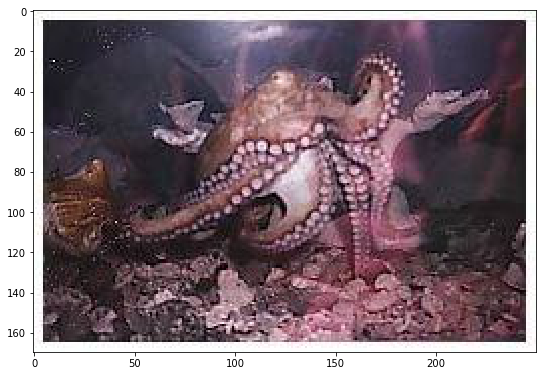



Probable category: skunk


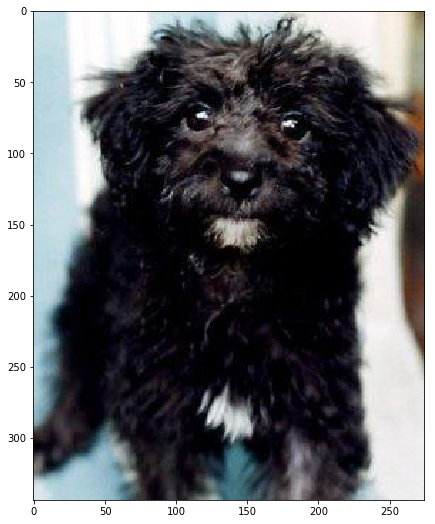



Probable category: elk


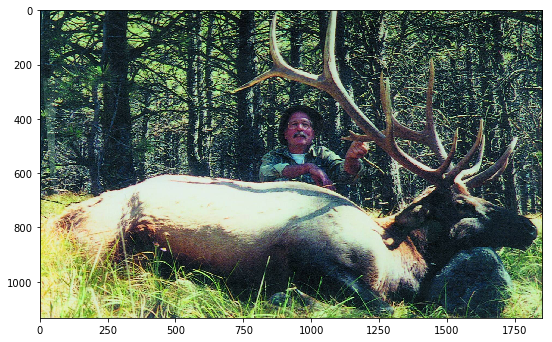



Probable category: gorilla


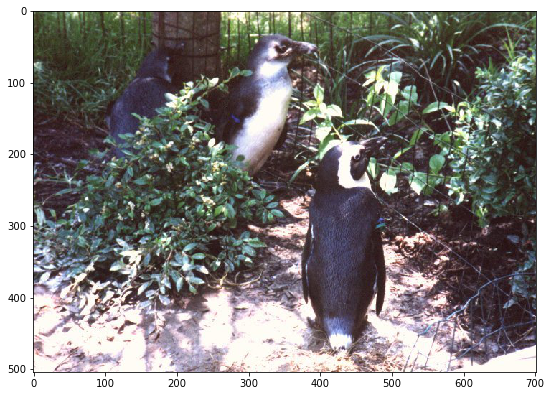



Probable category: teddy-bear


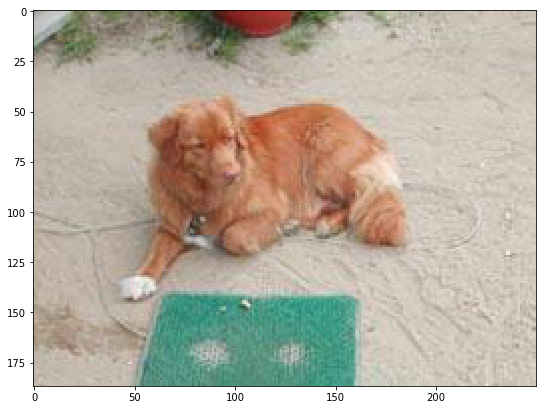



Probable category: hummingbird


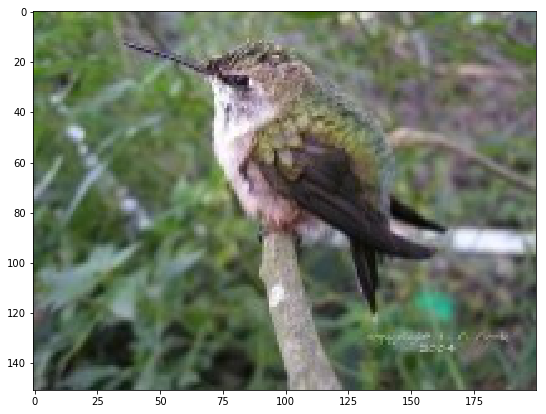



Probable category: unicorn


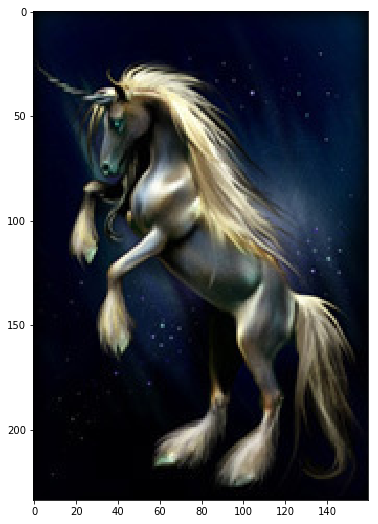



Probable category: gorilla


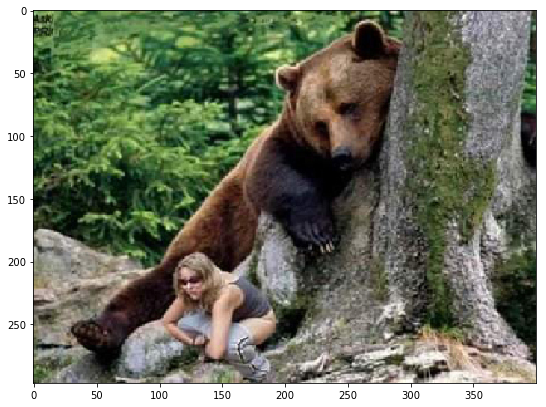



Probable category: airplanes


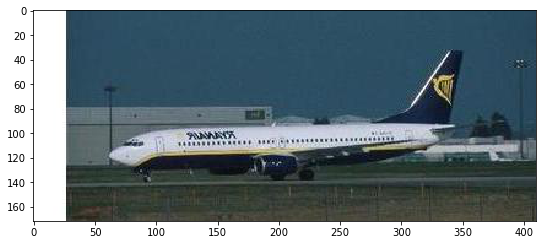



Probable category: gorilla


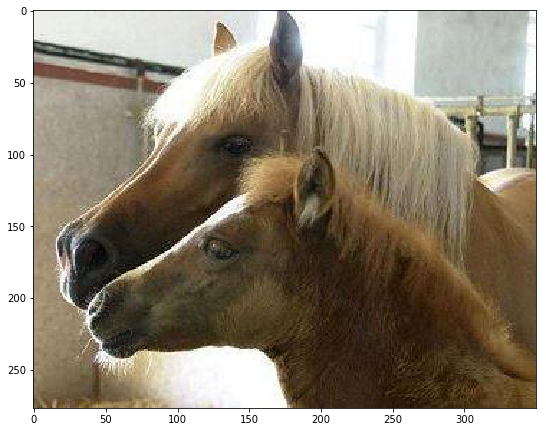



Probable category: iguana


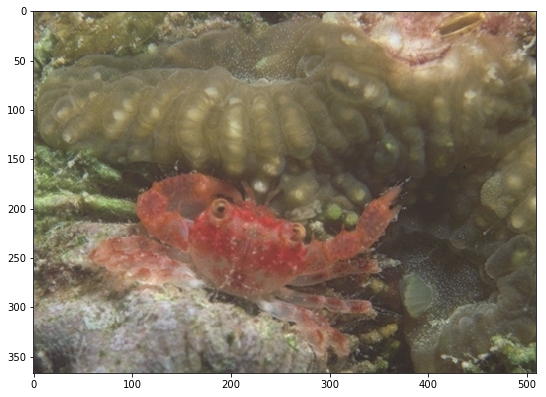



Probable category: hummingbird


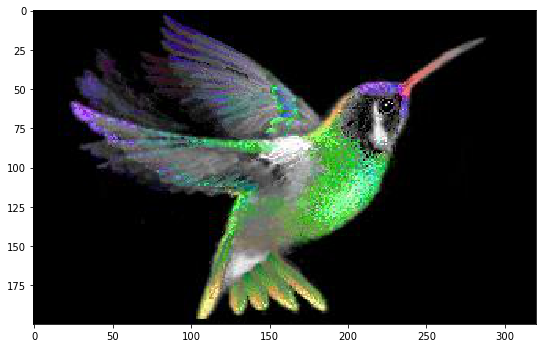



Probable category: galaxy


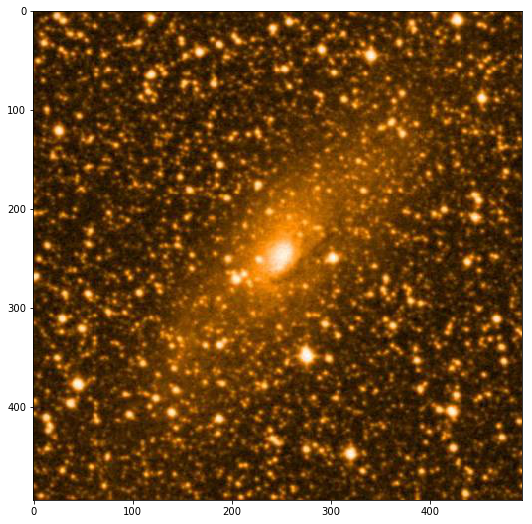



Probable category: swan


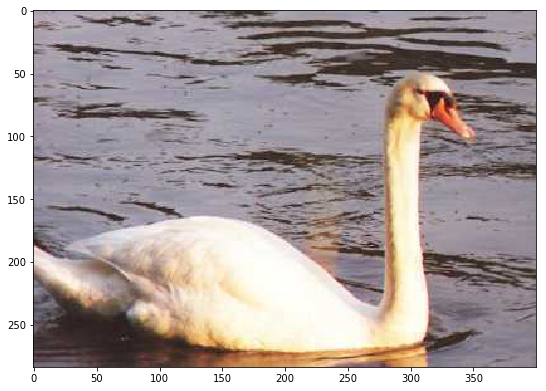



Probable category: mars


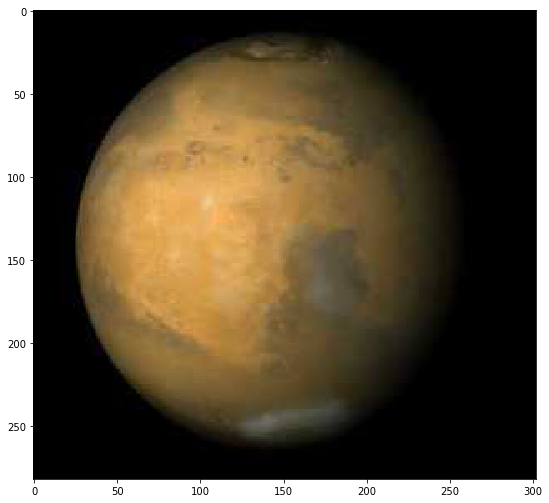



Probable category: swan


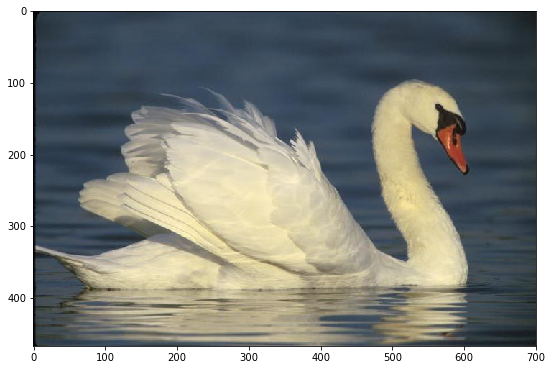



Probable category: goldfish


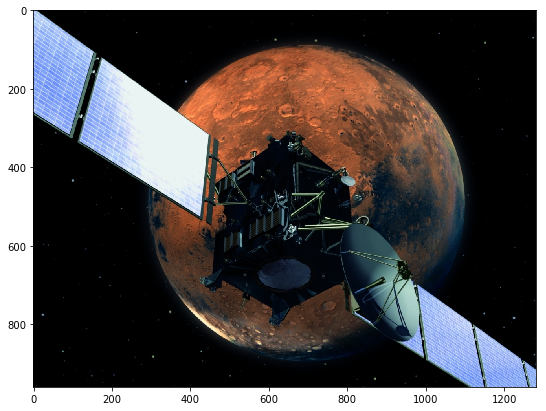



Probable category: octopus


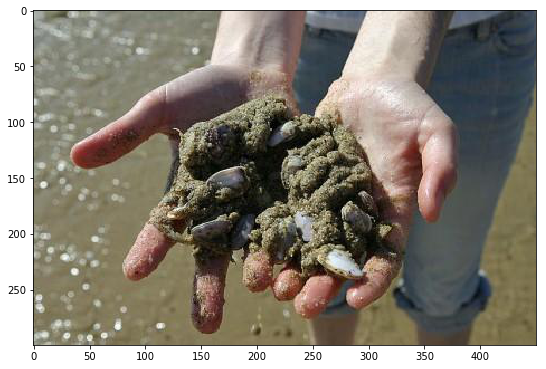



Probable category: gorilla


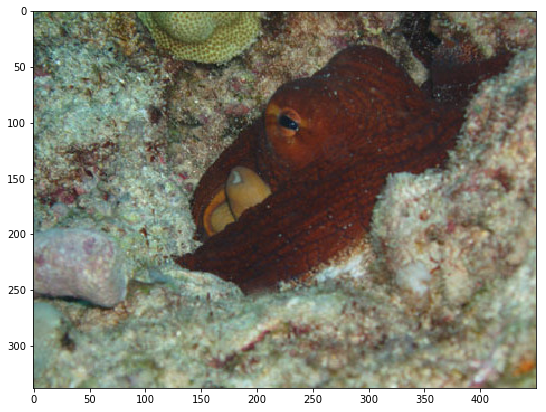



Probable category: blimp


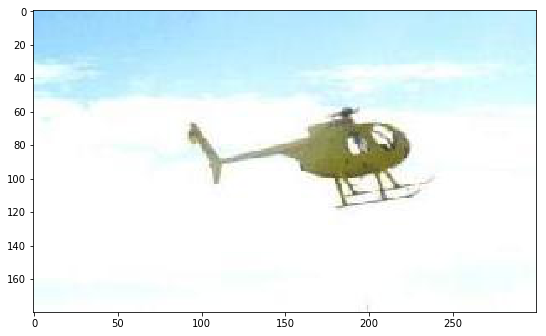



Probable category: mars


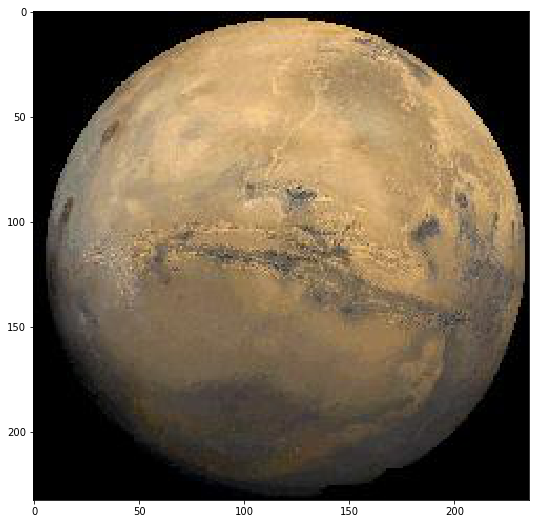



Probable category: skunk


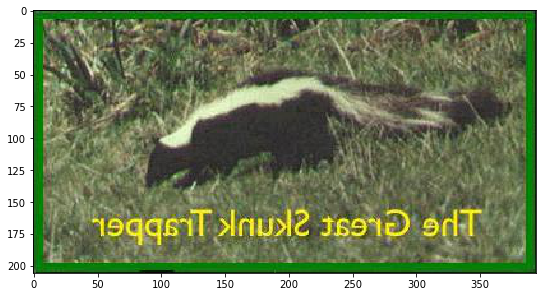



Probable category: snail


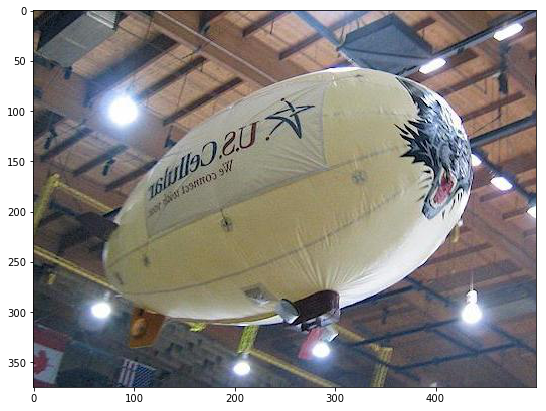



Probable category: raccoon


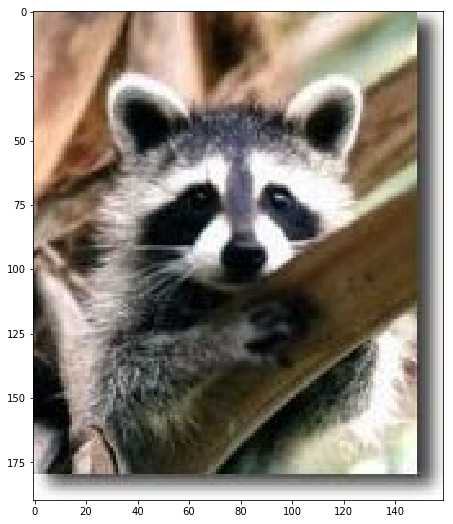



Probable category: killer-whale


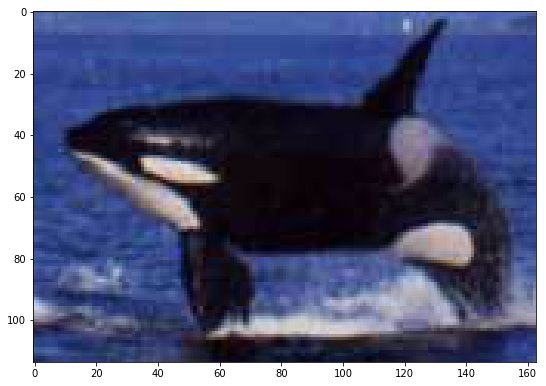



Probable category: ostrich


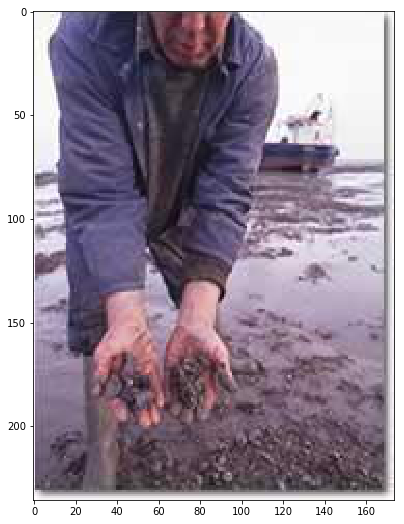



Probable category: raccoon


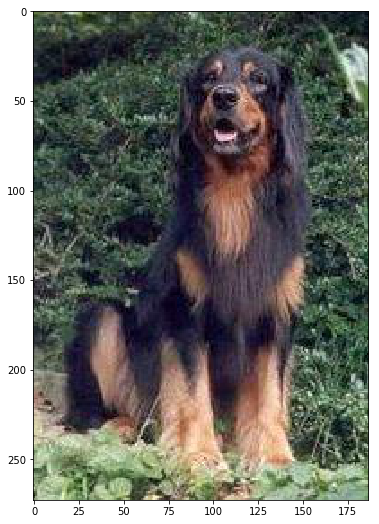



Probable category: mars


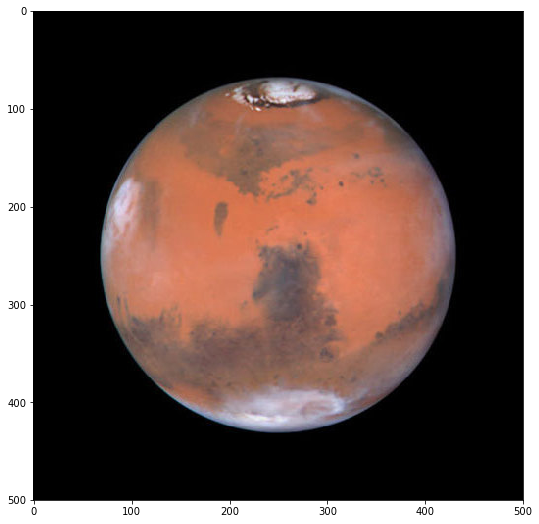



Probable category: iguana


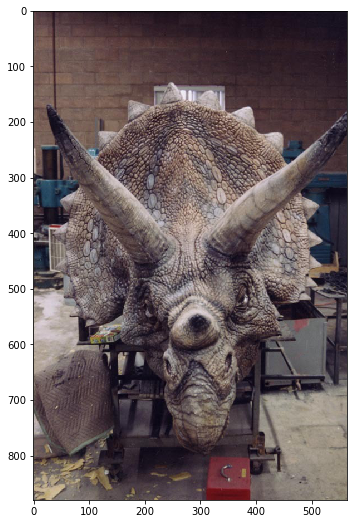



Probable category: airplanes


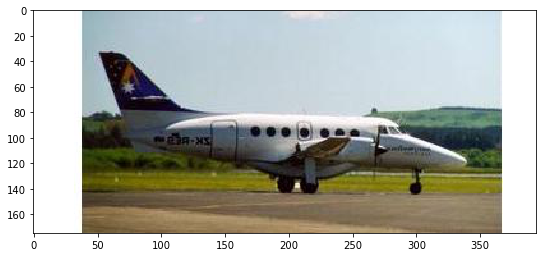



Probable category: gorilla


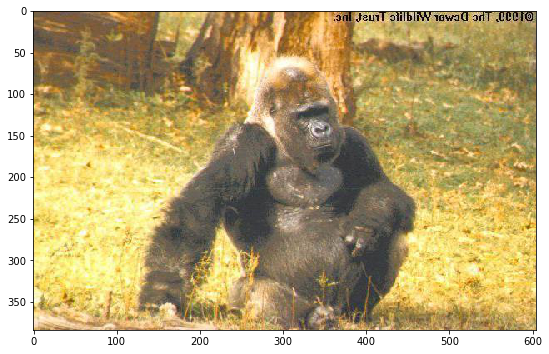



Probable category: owl


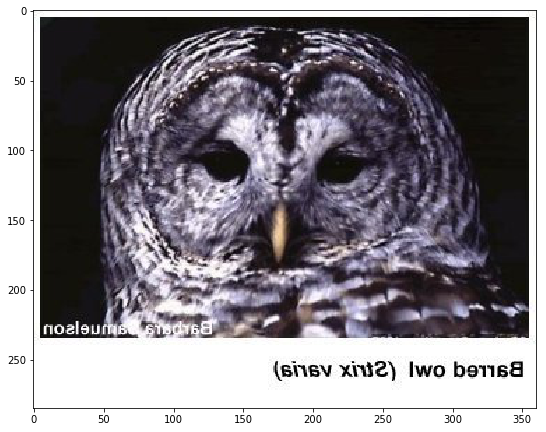



Probable category: elephant


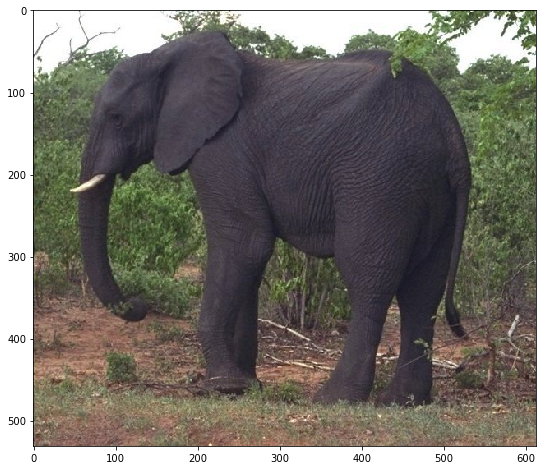



Probable category: teddy-bear


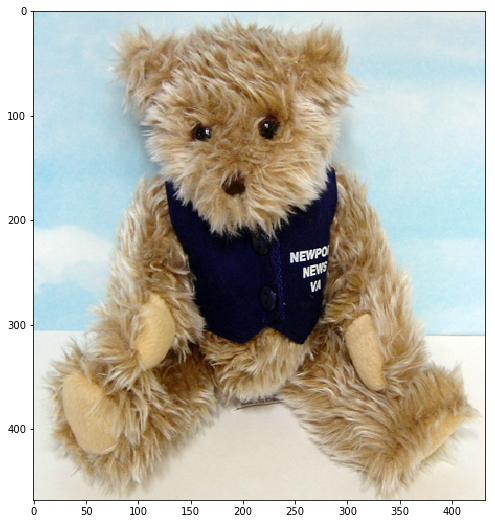



Probable category: cormorant


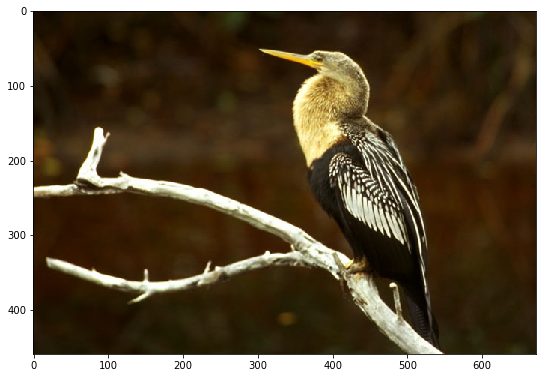



Probable category: owl


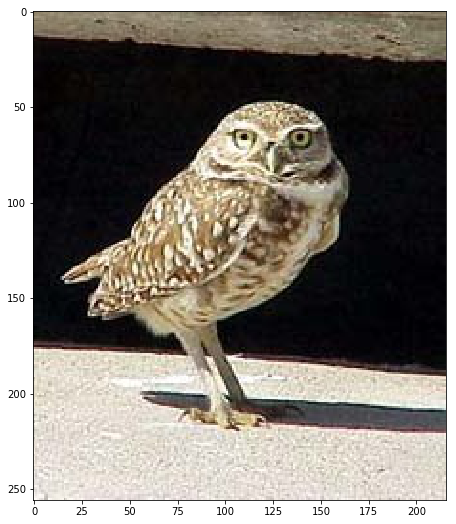



Probable category: unicorn


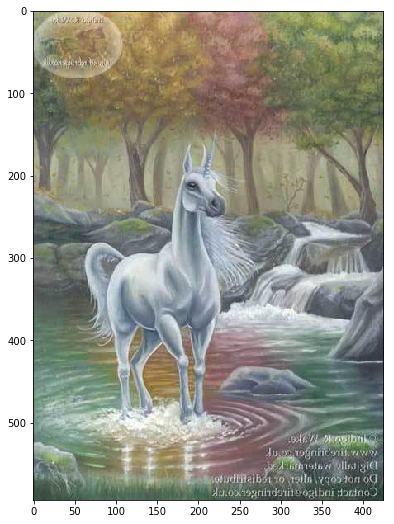



Probable category: frog


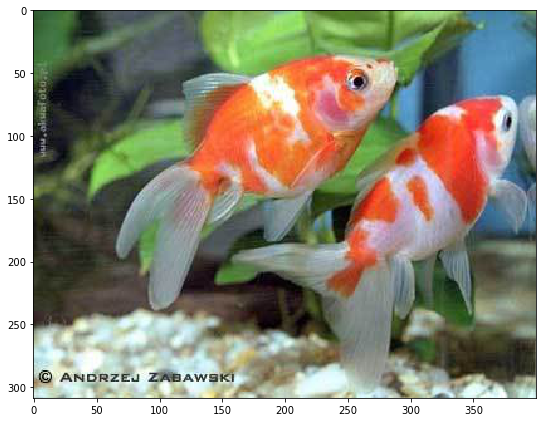



Probable category: goose


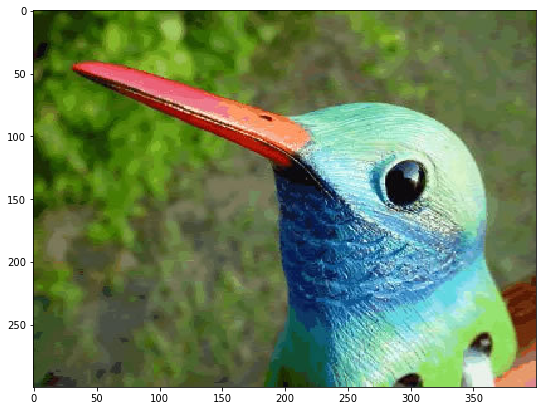



Probable category: camel


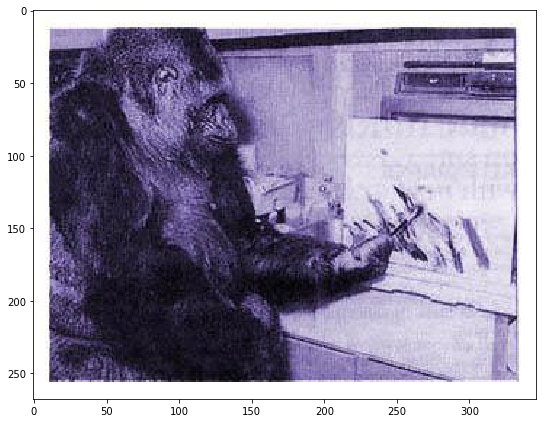



Probable category: blimp


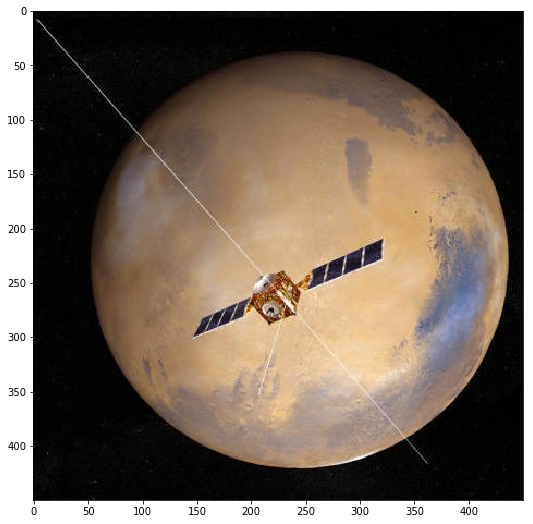



Probable category: airplanes


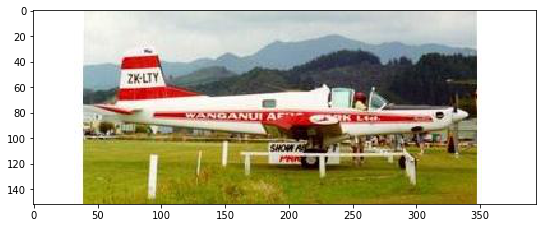



Probable category: skunk


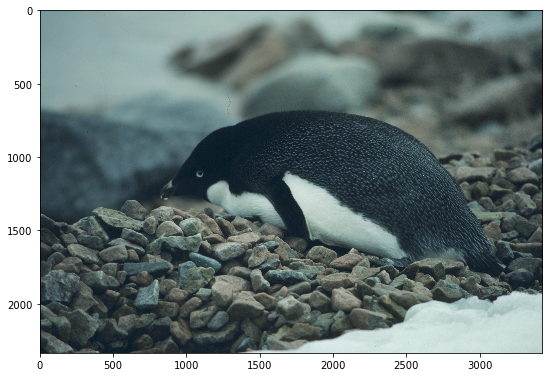



Probable category: mars


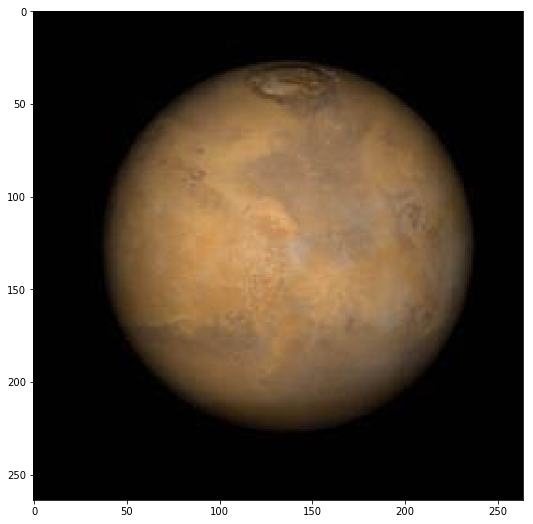



Probable category: elk


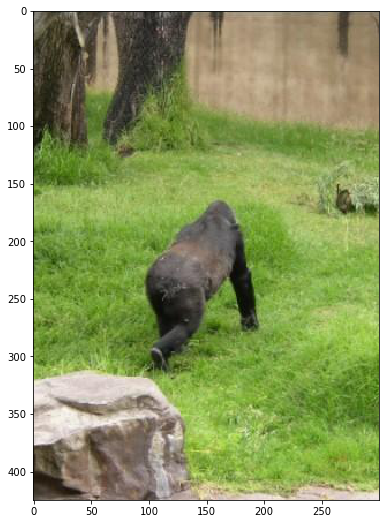



Probable category: snail


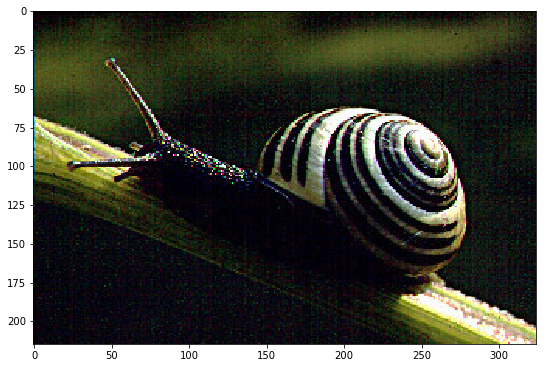

In [78]:
def predict(mod,i=0,r=None):
    preds = mod.predict_classes(X_test,verbose=0)
    
    if r==None:
        r=[i]
        
    for idx in r:
        
        img_path = path_test[idx]
        img = image.load_img(img_path, target_size=(150, 150))
        #x = image.img_to_array(img)
        #x = np.expand_dims(x, axis=0)
        class_pred = preds[idx]
        
        class_guess = img_cat_map[class_pred]
        
        print('\n\nProbable category: ' + class_guess)
        plot_pic(path_test[idx])

predict(model,r=range(0,100))

# As we can see below it is pretty accurate, however, for the case when we don't have many 
# training samples the accuracy is not as good.

<a id='sec3'></a>
# Appendix: Training a small convnet from scratch: 80% accuracy in 40 lines of code

The right tool for an image classification job is a convnet, so let's try to train one on our data, as an initial baseline. Since we only have few examples, our number one concern should be overfitting. Overfitting happens when a model exposed to too few examples learns patterns that do not generalize to new data, i.e. when the model starts using irrelevant features for making predictions. For instance, if you, as a human, only see three images of people who are lumberjacks, and three, images of people who are sailors, and among them only one lumberjack wears a cap, you might start thinking that wearing a cap is a sign of being a lumberjack as opposed to a sailor. You would then make a pretty lousy lumberjack/sailor classifier.

Data augmentation is one way to fight overfitting, but it isn't enough since our augmented samples are still highly correlated. Your main focus for fighting overfitting should be the entropic capacity of your model --how much information your model is allowed to store. A model that can store a lot of information has the potential to be more accurate by leveraging more features, but it is also more at risk to start storing irrelevant features. Meanwhile, a model that can only store a few features will have to focus on the most significant features found in the data, and these are more likely to be truly relevant and to generalize better.

There are different ways to modulate entropic capacity. The main one is the choice of the number of parameters in your model, i.e. the number of layers and the size of each layer. Another way is the use of weight regularization, such as L1 or L2 regularization, which consists in forcing model weights to taker smaller values.

In our case we will use a very small convnet with few layers and few filters per layer, alongside data augmentation and dropout. Dropout also helps reduce overfitting, by preventing a layer from seeing twice the exact same pattern, thus acting in a way analoguous to data augmentation (you could say that both dropout and data augmentation tend to disrupt random correlations occuring in your data).

The code snippet below is our first model, a simple stack of 3 convolution layers with a ReLU activation and followed by max-pooling layers. This is very similar to the architectures that Yann LeCun advocated in the 1990s for image classification (with the exception of ReLU).

In order to make the most of our few training examples, we will "augment" them via a number of random transformations, so that our model would never see twice the exact same picture. This helps prevent overfitting and helps the model generalize better.

In Keras this can be done via the keras.preprocessing.image.ImageDataGenerator class. This class allows you to:

configure random transformations and normalization operations to be done on your image data during training
instantiate generators of augmented image batches (and their labels) via .flow(data, labels) or .flow_from_directory(directory). These generators can then be used with the Keras model methods that accept data generators as inputs, fit_generator, evaluate_generator and predict_generator.

In [ ]:
# Import image data generator

datagen = ImageDataGenerator(
        rotation_range=40, #rotation_range degrees (0-180), range that randomly rotate pictures
        width_shift_range=0.2, #width_shift range (fraction of total width) within which to randomly translate pic
        height_shift_range=0.2, # -ii-
        
        #rescale value we multiply the data before any other processing. 
        #Our original images consist in RGB coefficients in the 0-255, 
        #but such values would be too high for our models to process (given typical learning rate), 
        # so we target values between 0 and 1 instead by scaling with a 1/255. factor.
        rescale=1./255,
        
        #randomly applying shearing transformations (shear mapping is a linear map that 
        #displaces each point in fixed direction, by an amount proportional to its 
        #signed distance from a line that is parallel to that direction)
        shear_range=0.2, 
        zoom_range=0.2, #randomly zooming inside pictures
        
        #is for randomly flipping half of the images horizontally 
        #--relevant when there are no assumptions of horizontal assymetry (e.g. real-world pictures).

        horizontal_flip=True,
    
        #is the strategy used for filling in newly created pixels, 
        #which can appear after a rotation or a width/height shift.
        fill_mode='nearest')

Now let's start generating some pictures using this tool and save them to a temporary directory, so we can get a feel for what our augmentation strategy is doing --we disable rescaling in this case to keep the images displayable:

In [ ]:
img = load_img(TRAIN_DIR+'cats/cat0001.jpg')  # this is a PIL image
x = img_to_array(img)  # this is a Numpy array with shape (3, 150, 150)
x = x.reshape((1,) + x.shape)  # this is a Numpy array with shape (1, 3, 150, 150)

# the .flow() command below generates batches of randomly transformed images
# and saves the results to the `preview/` directory
i = 0

if not os.path.exists('preview'):
    os.makedirs('preview')

for batch in datagen.flow(x, batch_size=1,
                          save_to_dir='preview', save_prefix='cat', save_format='jpeg'):
    i += 1
    if i > 20:
        break  # otherwise the generator would loop indefinitely

prev_files = os.walk('./preview').next()[2]
print(prev_files[:4])

for img in prev_files[1:4]:
    print('Image '+img)
    display(Image(filename='preview/'+img))

In [ ]:
def first_model():

    model = Sequential()
    model.add(Convolution2D(32, 3, 3, input_shape=(3, img_height, img_width)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Convolution2D(32, 3, 3))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Convolution2D(64, 3, 3))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    
    '''
    On top of it we stick two fully-connected layers. 
    We end the model with a single unit and a sigmoid activation, which is perfect for a binary classification. 
    To go with it we will also use the binary_crossentropy loss to train our model.
    '''

    model.add(Flatten())  # this converts our 3D feature maps to 1D feature vectors
    model.add(Dense(64))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1))
    model.add(Activation('sigmoid'))

    model.compile(loss='binary_crossentropy',
                  optimizer='rmsprop',
                  metrics=['accuracy'])
    
    
    # Let's prepare our data. We will use .flow_from_directory()
    # to generate batches of image data (and their labels) directly from our jpgs in their respective folders.
    
    # Below is the augmentation configuration we will use for training
    train_datagen = ImageDataGenerator(
            rescale=1./255,
            shear_range=0.2,
            zoom_range=0.2,
            horizontal_flip=True)

    # this is the augmentation configuration we will use for testing:
    # only rescaling
    test_datagen = ImageDataGenerator(rescale=1./255)

    # this is a generator that will read pictures found in
    # subfolers of 'data/train', and indefinitely generate
    # batches of augmented image data
    print('Train generator')
    train_generator = train_datagen.flow_from_directory(
            TRAIN_DIR,  # this is the target directory
            target_size=(img_height, img_width),  # all images will be resized to 150x150
            batch_size=32,
            class_mode='binary')  # since we use binary_crossentropy loss, we need binary labels

    # this is a similar generator, for validation data
    print('Validation generator')
    validation_generator = test_datagen.flow_from_directory(
            VAL_DIR,
            target_size=(img_height, img_width),
            batch_size=32,
            class_mode='binary')
    

    
    return model, train_generator, validation_generator

In [ ]:
# Look at class indices from our generators


_, train_gen,val_gen =first_model()
print('')
print(val_gen.class_indices)
print(val_gen.classes)

In [ ]:
# Define and fit the first model
n_epoch = 50
def fit_first_model():

    mod1, train_generator, validation_generator = first_model()
    mod1.fit_generator(
            train_generator,
            samples_per_epoch=n_train_samples,
            nb_epoch=n_epoch,
            validation_data=validation_generator,
            nb_val_samples=n_validation_samples)

    # save model to disk
    mod1.save_weights('w_appendix.h5')  # always save your weights after training or during training
    model_json = mod1.to_json()
    with open("mod_appendix.json", "w") as json_file:
        json_file.write(model_json)
    print("Saved model to disk")

#fit_first_model()


### DONE ###

In [ ]:
# FIRST MODEL EXPLORATION

# load model 1 and weights

json_file = open('mod_appendix.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
mod1 = model_from_json(loaded_model_json)
# load weights into new model
mod1.load_weights("w_appendix.h5")
print("Loaded model from disk")

mod1.compile(loss='binary_crossentropy',
                  optimizer='rmsprop',
                  metrics=['accuracy'])

# Extract image features from test set - to make predictions

datagen = ImageDataGenerator(rescale=1./255)

# this is a similar generator, for validation data
val_generator = datagen.flow_from_directory( VAL_DIR, target_size=(img_height, img_width),
                                              batch_size=32,class_mode='binary')

preds = mod1.evaluate_generator(val_generator,n_validation_samples)

print('\nModel 1 accuracy on 800 validation images:', round(sum(preds)/2,4)*100,'%')

In [ ]:
# Plot picture and print class prediction on cats vs dogs (unsorted)


try_images =  [TEST_DIR+'catvdog/'+img for img in os.listdir(TEST_DIR+'catvdog/')]

def read_image(file_path):
    # For image visualization
    img = cv2.imread(file_path, cv2.IMREAD_COLOR) #cv2.IMREAD_GRAYSCALE
    return cv2.resize(img, (img_height, img_width), interpolation=cv2.INTER_CUBIC)

def plot_pic(img):
    # Plot openCV pic
    pic = read_image(img)    
    plt.figure(figsize=(5,5))
    plt.imshow(pic)
    plt.show()

def predict(mod,i=0,r=None):
    if r==None:
        r=[i]
        
    for idx in r:
        
        img_path = try_images[idx]
        img = image.load_img(img_path, target_size=(150, 150))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        class_pred = mod.predict_classes(x,verbose=0)
        
        if class_pred == 0:
            class_guess='CAT'
        else:
            class_guess='DOG'
        
        print('\n\nI think this is a ' + class_guess)
        plot_pic(try_images[idx])

predict(mod1,r=range(1,10))